# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/matplotlib/__init__.py:1067: UserWarning: Duplicate key in file "/home/ec2-user/.config/matplotlib/matplotlibrc", line #2
  (fname, cnt))
/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/matplotlib/__init__.py:1067: UserWarning: Duplicate key in file "/home/ec2-user/.config/matplotlib/matplotlibrc", line #3
  (fname, cnt))
/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:03, 53.5MB/s]                            
SVHN Testing Set: 64.3MB [00:02, 24.8MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

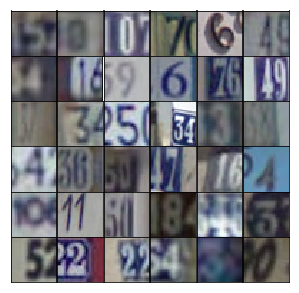

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(self.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.7861... Generator Loss: 0.3670
Epoch 1/25... Discriminator Loss: 0.4813... Generator Loss: 1.5049
Epoch 1/25... Discriminator Loss: 0.2198... Generator Loss: 2.1704
Epoch 1/25... Discriminator Loss: 0.1380... Generator Loss: 3.0622
Epoch 1/25... Discriminator Loss: 0.1823... Generator Loss: 2.6139
Epoch 1/25... Discriminator Loss: 0.1188... Generator Loss: 3.0069
Epoch 1/25... Discriminator Loss: 0.1013... Generator Loss: 3.2468
Epoch 1/25... Discriminator Loss: 0.5367... Generator Loss: 1.4190
Epoch 1/25... Discriminator Loss: 0.1406... Generator Loss: 2.8693
Epoch 1/25... Discriminator Loss: 0.2544... Generator Loss: 2.9849


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


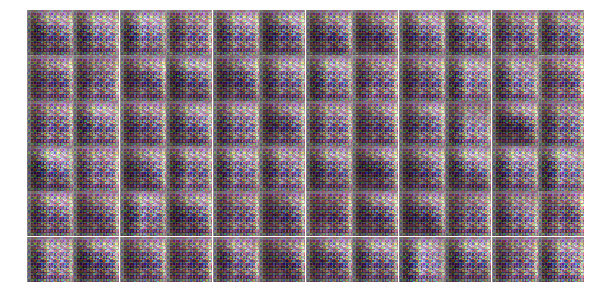

Epoch 1/25... Discriminator Loss: 0.1862... Generator Loss: 3.0582
Epoch 1/25... Discriminator Loss: 0.7896... Generator Loss: 1.0729
Epoch 1/25... Discriminator Loss: 0.6216... Generator Loss: 1.3257
Epoch 1/25... Discriminator Loss: 0.6012... Generator Loss: 1.4232
Epoch 1/25... Discriminator Loss: 0.6999... Generator Loss: 2.2112
Epoch 1/25... Discriminator Loss: 0.5361... Generator Loss: 2.7385
Epoch 1/25... Discriminator Loss: 0.4571... Generator Loss: 1.6517
Epoch 1/25... Discriminator Loss: 0.6486... Generator Loss: 2.4097
Epoch 1/25... Discriminator Loss: 0.5421... Generator Loss: 3.4031
Epoch 1/25... Discriminator Loss: 0.1407... Generator Loss: 3.0852


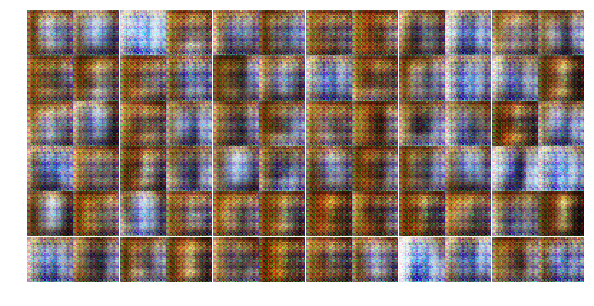

Epoch 1/25... Discriminator Loss: 0.2160... Generator Loss: 2.1972
Epoch 1/25... Discriminator Loss: 1.0197... Generator Loss: 5.7349
Epoch 1/25... Discriminator Loss: 0.5719... Generator Loss: 3.9011
Epoch 1/25... Discriminator Loss: 0.9218... Generator Loss: 0.7407
Epoch 1/25... Discriminator Loss: 0.5259... Generator Loss: 1.4075
Epoch 1/25... Discriminator Loss: 0.4331... Generator Loss: 1.5299
Epoch 1/25... Discriminator Loss: 1.6602... Generator Loss: 4.3971
Epoch 1/25... Discriminator Loss: 0.9494... Generator Loss: 1.5785
Epoch 1/25... Discriminator Loss: 0.9459... Generator Loss: 1.5240
Epoch 1/25... Discriminator Loss: 1.2462... Generator Loss: 1.1947


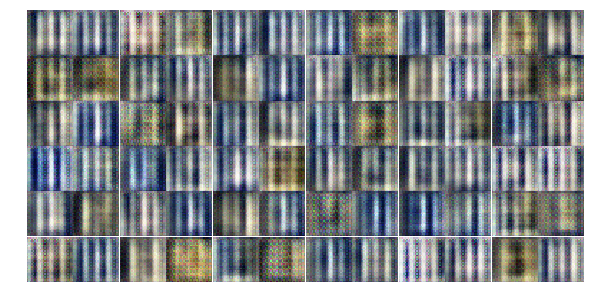

Epoch 1/25... Discriminator Loss: 0.7080... Generator Loss: 1.3721
Epoch 1/25... Discriminator Loss: 0.7943... Generator Loss: 1.3161
Epoch 1/25... Discriminator Loss: 0.8373... Generator Loss: 1.2428
Epoch 1/25... Discriminator Loss: 1.0671... Generator Loss: 0.9573
Epoch 1/25... Discriminator Loss: 0.7489... Generator Loss: 1.3831
Epoch 1/25... Discriminator Loss: 0.4908... Generator Loss: 1.7796
Epoch 1/25... Discriminator Loss: 1.0261... Generator Loss: 0.5991
Epoch 1/25... Discriminator Loss: 0.6123... Generator Loss: 1.5385
Epoch 1/25... Discriminator Loss: 0.5086... Generator Loss: 1.7917
Epoch 1/25... Discriminator Loss: 0.5562... Generator Loss: 1.5985


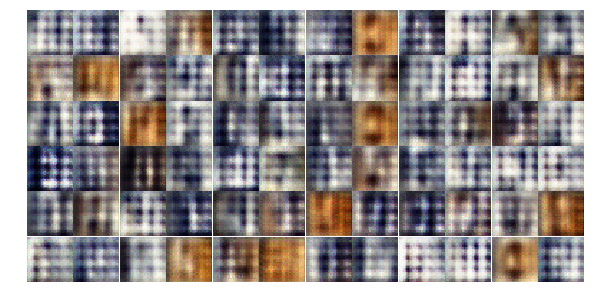

Epoch 1/25... Discriminator Loss: 0.3624... Generator Loss: 2.0781
Epoch 1/25... Discriminator Loss: 0.5210... Generator Loss: 1.6405
Epoch 1/25... Discriminator Loss: 0.5246... Generator Loss: 1.9659
Epoch 1/25... Discriminator Loss: 0.8540... Generator Loss: 1.8070
Epoch 1/25... Discriminator Loss: 0.9112... Generator Loss: 3.3451
Epoch 1/25... Discriminator Loss: 0.8918... Generator Loss: 1.8542
Epoch 1/25... Discriminator Loss: 0.6997... Generator Loss: 1.4256
Epoch 1/25... Discriminator Loss: 0.8477... Generator Loss: 1.7355
Epoch 1/25... Discriminator Loss: 0.9845... Generator Loss: 0.8798
Epoch 1/25... Discriminator Loss: 0.6354... Generator Loss: 1.4100


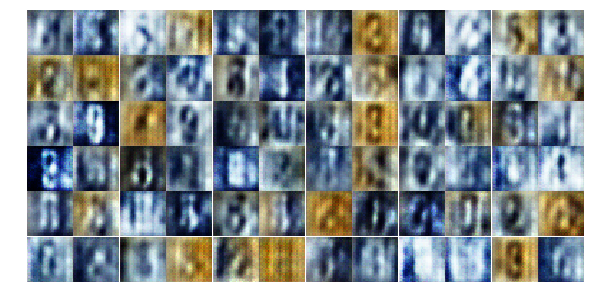

Epoch 1/25... Discriminator Loss: 0.8233... Generator Loss: 1.1138
Epoch 1/25... Discriminator Loss: 0.9237... Generator Loss: 0.9769
Epoch 1/25... Discriminator Loss: 1.0761... Generator Loss: 2.4404
Epoch 1/25... Discriminator Loss: 1.7286... Generator Loss: 0.4459
Epoch 1/25... Discriminator Loss: 0.9128... Generator Loss: 0.8102
Epoch 1/25... Discriminator Loss: 0.8554... Generator Loss: 0.8550
Epoch 1/25... Discriminator Loss: 0.6696... Generator Loss: 1.8536
Epoch 2/25... Discriminator Loss: 0.8714... Generator Loss: 1.4981
Epoch 2/25... Discriminator Loss: 0.8517... Generator Loss: 1.3200
Epoch 2/25... Discriminator Loss: 1.4050... Generator Loss: 0.6071


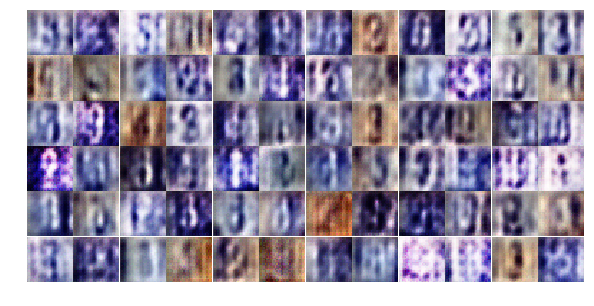

Epoch 2/25... Discriminator Loss: 1.3345... Generator Loss: 0.8961
Epoch 2/25... Discriminator Loss: 1.3284... Generator Loss: 0.7368
Epoch 2/25... Discriminator Loss: 1.0470... Generator Loss: 0.9941
Epoch 2/25... Discriminator Loss: 1.0770... Generator Loss: 1.0278
Epoch 2/25... Discriminator Loss: 1.0648... Generator Loss: 0.7952
Epoch 2/25... Discriminator Loss: 1.1649... Generator Loss: 1.0587
Epoch 2/25... Discriminator Loss: 1.0725... Generator Loss: 0.9988
Epoch 2/25... Discriminator Loss: 0.7530... Generator Loss: 1.7829
Epoch 2/25... Discriminator Loss: 0.7941... Generator Loss: 1.1197
Epoch 2/25... Discriminator Loss: 0.8613... Generator Loss: 0.9834


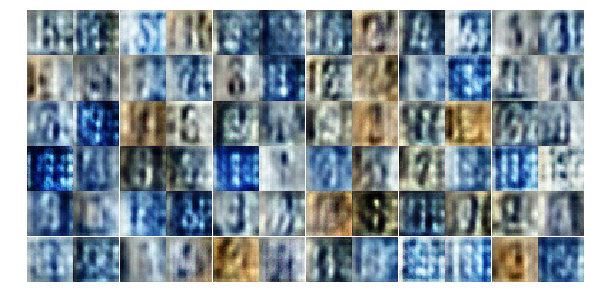

Epoch 2/25... Discriminator Loss: 0.9115... Generator Loss: 1.1052
Epoch 2/25... Discriminator Loss: 0.7793... Generator Loss: 1.5702
Epoch 2/25... Discriminator Loss: 0.8772... Generator Loss: 1.3706
Epoch 2/25... Discriminator Loss: 0.7194... Generator Loss: 1.3516
Epoch 2/25... Discriminator Loss: 1.1304... Generator Loss: 1.2332
Epoch 2/25... Discriminator Loss: 1.2090... Generator Loss: 0.7195
Epoch 2/25... Discriminator Loss: 1.3020... Generator Loss: 0.5458
Epoch 2/25... Discriminator Loss: 1.2129... Generator Loss: 0.7969
Epoch 2/25... Discriminator Loss: 1.1401... Generator Loss: 0.7865
Epoch 2/25... Discriminator Loss: 0.9198... Generator Loss: 0.8590


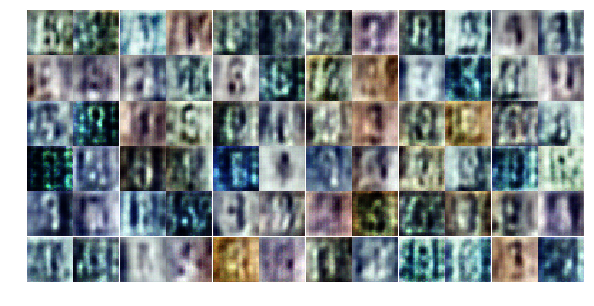

Epoch 2/25... Discriminator Loss: 1.2871... Generator Loss: 0.6198
Epoch 2/25... Discriminator Loss: 0.8050... Generator Loss: 1.2686
Epoch 2/25... Discriminator Loss: 0.7099... Generator Loss: 1.3182
Epoch 2/25... Discriminator Loss: 1.1099... Generator Loss: 1.3867
Epoch 2/25... Discriminator Loss: 1.1079... Generator Loss: 0.9990
Epoch 2/25... Discriminator Loss: 1.0174... Generator Loss: 1.0825
Epoch 2/25... Discriminator Loss: 0.9367... Generator Loss: 1.1055
Epoch 2/25... Discriminator Loss: 1.2959... Generator Loss: 0.5445
Epoch 2/25... Discriminator Loss: 1.0489... Generator Loss: 0.9990
Epoch 2/25... Discriminator Loss: 1.1272... Generator Loss: 1.1366


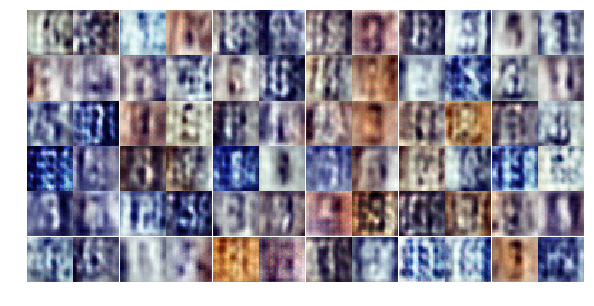

Epoch 2/25... Discriminator Loss: 1.2255... Generator Loss: 0.6997
Epoch 2/25... Discriminator Loss: 1.1365... Generator Loss: 0.8617
Epoch 2/25... Discriminator Loss: 1.0546... Generator Loss: 1.2229
Epoch 2/25... Discriminator Loss: 1.0687... Generator Loss: 0.8382
Epoch 2/25... Discriminator Loss: 0.8565... Generator Loss: 1.1741
Epoch 2/25... Discriminator Loss: 1.1217... Generator Loss: 0.7011
Epoch 2/25... Discriminator Loss: 1.0811... Generator Loss: 0.9752
Epoch 2/25... Discriminator Loss: 0.9202... Generator Loss: 1.2817
Epoch 2/25... Discriminator Loss: 0.9209... Generator Loss: 1.7800
Epoch 2/25... Discriminator Loss: 0.8810... Generator Loss: 1.5186


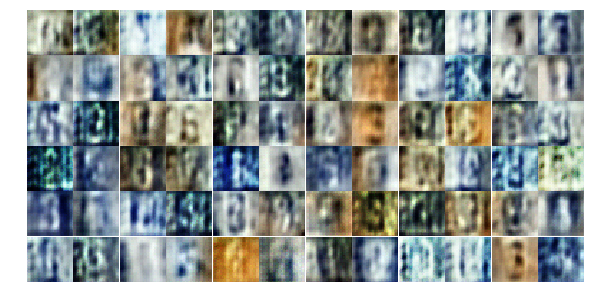

Epoch 2/25... Discriminator Loss: 0.9470... Generator Loss: 0.9617
Epoch 2/25... Discriminator Loss: 1.1389... Generator Loss: 0.9165
Epoch 2/25... Discriminator Loss: 0.7848... Generator Loss: 1.6173
Epoch 2/25... Discriminator Loss: 1.1076... Generator Loss: 1.0043
Epoch 2/25... Discriminator Loss: 0.9694... Generator Loss: 0.9939
Epoch 2/25... Discriminator Loss: 0.9919... Generator Loss: 0.8723
Epoch 2/25... Discriminator Loss: 0.9939... Generator Loss: 0.9556
Epoch 2/25... Discriminator Loss: 0.9136... Generator Loss: 2.4600
Epoch 2/25... Discriminator Loss: 0.8364... Generator Loss: 1.2653
Epoch 2/25... Discriminator Loss: 1.0732... Generator Loss: 2.0845


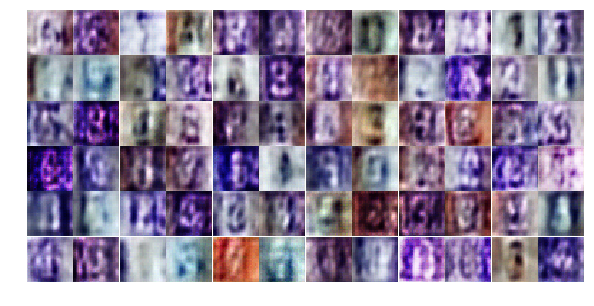

Epoch 2/25... Discriminator Loss: 0.8649... Generator Loss: 0.9759
Epoch 2/25... Discriminator Loss: 0.7726... Generator Loss: 1.1735
Epoch 2/25... Discriminator Loss: 1.1260... Generator Loss: 0.8800
Epoch 2/25... Discriminator Loss: 1.3168... Generator Loss: 3.6989
Epoch 3/25... Discriminator Loss: 0.7253... Generator Loss: 2.0719
Epoch 3/25... Discriminator Loss: 0.9348... Generator Loss: 1.0079
Epoch 3/25... Discriminator Loss: 0.9032... Generator Loss: 1.7672
Epoch 3/25... Discriminator Loss: 0.8631... Generator Loss: 1.6597
Epoch 3/25... Discriminator Loss: 0.5891... Generator Loss: 1.6853
Epoch 3/25... Discriminator Loss: 0.6195... Generator Loss: 1.5031


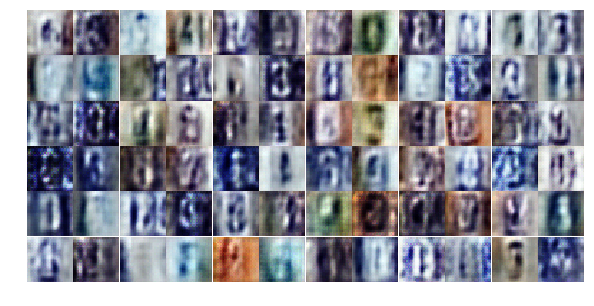

Epoch 3/25... Discriminator Loss: 0.6743... Generator Loss: 1.2016
Epoch 3/25... Discriminator Loss: 0.6507... Generator Loss: 1.2009
Epoch 3/25... Discriminator Loss: 0.5878... Generator Loss: 1.5272
Epoch 3/25... Discriminator Loss: 0.6736... Generator Loss: 1.2797
Epoch 3/25... Discriminator Loss: 1.1528... Generator Loss: 0.5869
Epoch 3/25... Discriminator Loss: 0.9213... Generator Loss: 0.8564
Epoch 3/25... Discriminator Loss: 0.8545... Generator Loss: 1.0005
Epoch 3/25... Discriminator Loss: 0.5384... Generator Loss: 1.8663
Epoch 3/25... Discriminator Loss: 1.5711... Generator Loss: 2.5371
Epoch 3/25... Discriminator Loss: 0.8600... Generator Loss: 1.0635


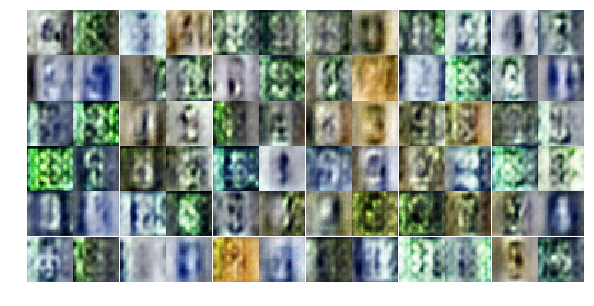

Epoch 3/25... Discriminator Loss: 0.9718... Generator Loss: 0.8479
Epoch 3/25... Discriminator Loss: 0.5781... Generator Loss: 1.4560
Epoch 3/25... Discriminator Loss: 0.7743... Generator Loss: 1.4827
Epoch 3/25... Discriminator Loss: 0.6548... Generator Loss: 1.2571
Epoch 3/25... Discriminator Loss: 0.6027... Generator Loss: 1.6876
Epoch 3/25... Discriminator Loss: 0.4850... Generator Loss: 1.5646
Epoch 3/25... Discriminator Loss: 0.8541... Generator Loss: 1.4684
Epoch 3/25... Discriminator Loss: 0.6393... Generator Loss: 1.2392
Epoch 3/25... Discriminator Loss: 0.9975... Generator Loss: 0.8961
Epoch 3/25... Discriminator Loss: 1.3660... Generator Loss: 0.4963


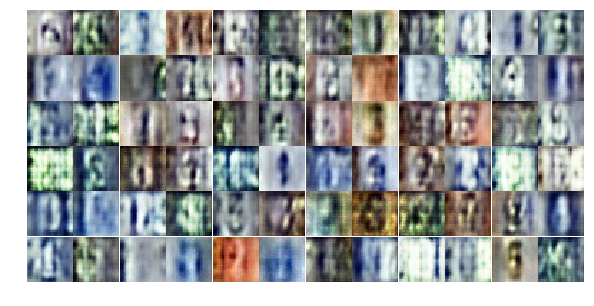

Epoch 3/25... Discriminator Loss: 0.7862... Generator Loss: 1.1482
Epoch 3/25... Discriminator Loss: 0.6335... Generator Loss: 1.8053
Epoch 3/25... Discriminator Loss: 0.7691... Generator Loss: 0.9984
Epoch 3/25... Discriminator Loss: 0.5666... Generator Loss: 1.3229
Epoch 3/25... Discriminator Loss: 1.1140... Generator Loss: 1.5938
Epoch 3/25... Discriminator Loss: 0.7400... Generator Loss: 1.1391
Epoch 3/25... Discriminator Loss: 0.8090... Generator Loss: 0.9803
Epoch 3/25... Discriminator Loss: 0.5086... Generator Loss: 1.7815
Epoch 3/25... Discriminator Loss: 0.9311... Generator Loss: 1.4914
Epoch 3/25... Discriminator Loss: 1.1915... Generator Loss: 0.5269


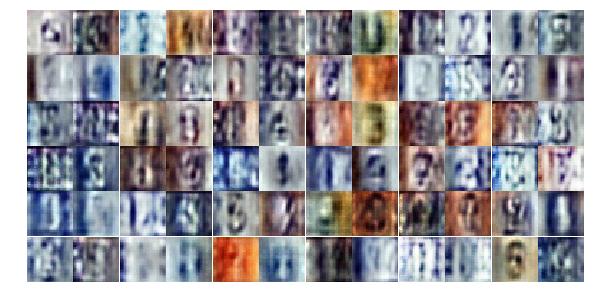

Epoch 3/25... Discriminator Loss: 0.5614... Generator Loss: 1.3696
Epoch 3/25... Discriminator Loss: 0.6025... Generator Loss: 2.3266
Epoch 3/25... Discriminator Loss: 0.7155... Generator Loss: 1.8349
Epoch 3/25... Discriminator Loss: 0.6302... Generator Loss: 1.3067
Epoch 3/25... Discriminator Loss: 0.7538... Generator Loss: 1.3921
Epoch 3/25... Discriminator Loss: 0.7846... Generator Loss: 0.9413
Epoch 3/25... Discriminator Loss: 0.6555... Generator Loss: 2.1101
Epoch 3/25... Discriminator Loss: 0.6109... Generator Loss: 1.2133
Epoch 3/25... Discriminator Loss: 1.6659... Generator Loss: 3.0425
Epoch 3/25... Discriminator Loss: 0.9329... Generator Loss: 1.1643


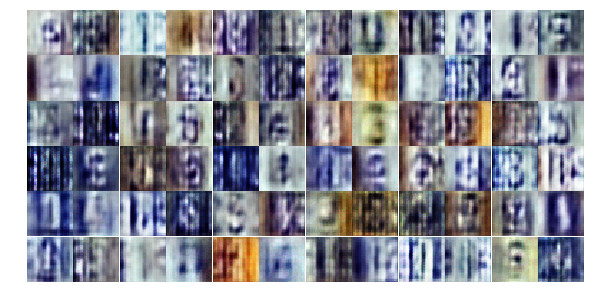

Epoch 3/25... Discriminator Loss: 1.3096... Generator Loss: 0.6118
Epoch 3/25... Discriminator Loss: 1.3541... Generator Loss: 0.4476
Epoch 3/25... Discriminator Loss: 0.6658... Generator Loss: 1.1485
Epoch 3/25... Discriminator Loss: 0.6734... Generator Loss: 1.5283
Epoch 3/25... Discriminator Loss: 0.6419... Generator Loss: 1.2004
Epoch 3/25... Discriminator Loss: 0.5116... Generator Loss: 1.5169
Epoch 3/25... Discriminator Loss: 0.5539... Generator Loss: 2.1309
Epoch 3/25... Discriminator Loss: 0.8295... Generator Loss: 1.0034
Epoch 3/25... Discriminator Loss: 0.8002... Generator Loss: 1.6010
Epoch 3/25... Discriminator Loss: 0.7301... Generator Loss: 1.1461


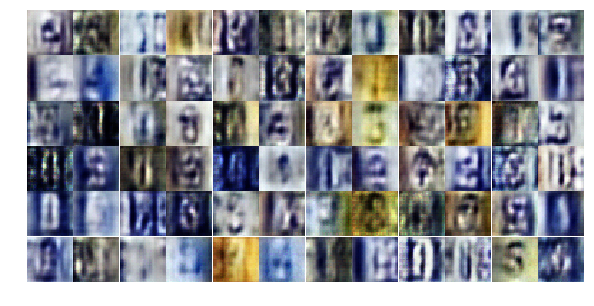

Epoch 3/25... Discriminator Loss: 0.8038... Generator Loss: 1.2507
Epoch 4/25... Discriminator Loss: 1.1421... Generator Loss: 0.5523
Epoch 4/25... Discriminator Loss: 0.8038... Generator Loss: 1.3280
Epoch 4/25... Discriminator Loss: 0.8752... Generator Loss: 0.8217
Epoch 4/25... Discriminator Loss: 0.8082... Generator Loss: 2.2149
Epoch 4/25... Discriminator Loss: 0.8507... Generator Loss: 2.4227
Epoch 4/25... Discriminator Loss: 0.6146... Generator Loss: 1.9708
Epoch 4/25... Discriminator Loss: 0.8413... Generator Loss: 1.1514
Epoch 4/25... Discriminator Loss: 0.7955... Generator Loss: 1.6828
Epoch 4/25... Discriminator Loss: 0.5722... Generator Loss: 1.7127


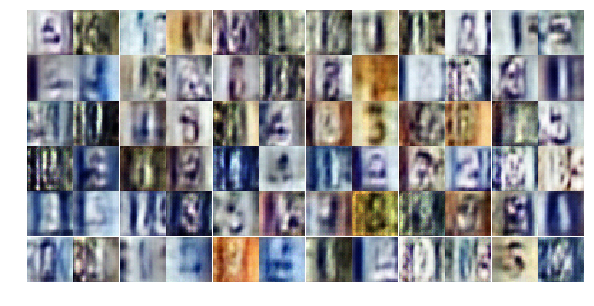

Epoch 4/25... Discriminator Loss: 0.6513... Generator Loss: 1.7104
Epoch 4/25... Discriminator Loss: 0.5316... Generator Loss: 1.3185
Epoch 4/25... Discriminator Loss: 0.7535... Generator Loss: 1.0764
Epoch 4/25... Discriminator Loss: 0.5349... Generator Loss: 2.6725
Epoch 4/25... Discriminator Loss: 0.7905... Generator Loss: 2.4273
Epoch 4/25... Discriminator Loss: 1.6187... Generator Loss: 0.2921
Epoch 4/25... Discriminator Loss: 0.8826... Generator Loss: 0.9348
Epoch 4/25... Discriminator Loss: 0.8999... Generator Loss: 0.7237
Epoch 4/25... Discriminator Loss: 0.7420... Generator Loss: 1.1162
Epoch 4/25... Discriminator Loss: 0.5301... Generator Loss: 1.4090


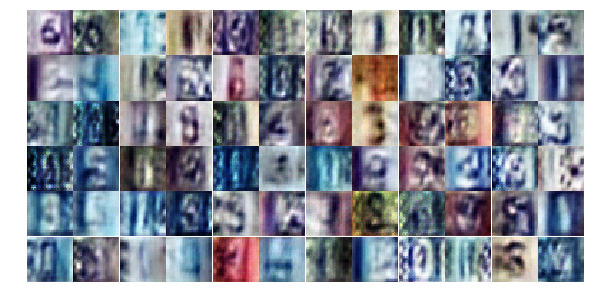

Epoch 4/25... Discriminator Loss: 0.5592... Generator Loss: 1.3599
Epoch 4/25... Discriminator Loss: 0.4668... Generator Loss: 1.8171
Epoch 4/25... Discriminator Loss: 0.6202... Generator Loss: 1.4444
Epoch 4/25... Discriminator Loss: 0.5410... Generator Loss: 1.4823
Epoch 4/25... Discriminator Loss: 0.9863... Generator Loss: 0.7110
Epoch 4/25... Discriminator Loss: 0.8710... Generator Loss: 2.1280
Epoch 4/25... Discriminator Loss: 0.6244... Generator Loss: 1.0654
Epoch 4/25... Discriminator Loss: 0.4348... Generator Loss: 1.8050
Epoch 4/25... Discriminator Loss: 0.2449... Generator Loss: 2.9106
Epoch 4/25... Discriminator Loss: 0.6952... Generator Loss: 1.1584


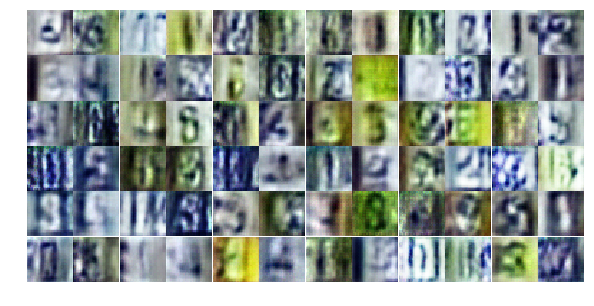

Epoch 4/25... Discriminator Loss: 0.6875... Generator Loss: 1.0994
Epoch 4/25... Discriminator Loss: 0.7092... Generator Loss: 1.2701
Epoch 4/25... Discriminator Loss: 0.7676... Generator Loss: 0.9446
Epoch 4/25... Discriminator Loss: 0.5132... Generator Loss: 1.7024
Epoch 4/25... Discriminator Loss: 0.4036... Generator Loss: 2.2716
Epoch 4/25... Discriminator Loss: 1.1126... Generator Loss: 0.5457
Epoch 4/25... Discriminator Loss: 0.6931... Generator Loss: 2.5154
Epoch 4/25... Discriminator Loss: 0.6370... Generator Loss: 1.3018
Epoch 4/25... Discriminator Loss: 0.6825... Generator Loss: 1.0408
Epoch 4/25... Discriminator Loss: 0.9014... Generator Loss: 0.7881


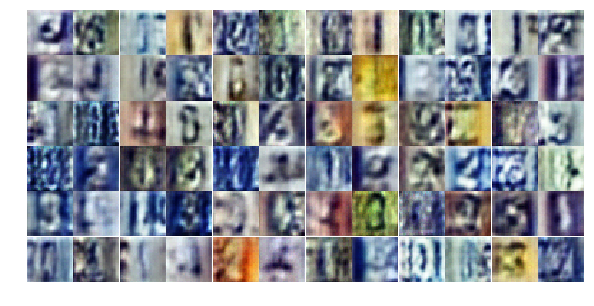

Epoch 4/25... Discriminator Loss: 0.5772... Generator Loss: 1.2793
Epoch 4/25... Discriminator Loss: 0.4099... Generator Loss: 1.5915
Epoch 4/25... Discriminator Loss: 0.5887... Generator Loss: 1.2527
Epoch 4/25... Discriminator Loss: 0.4146... Generator Loss: 1.9605
Epoch 4/25... Discriminator Loss: 0.4017... Generator Loss: 2.0624
Epoch 4/25... Discriminator Loss: 0.9555... Generator Loss: 3.0277
Epoch 4/25... Discriminator Loss: 0.7379... Generator Loss: 0.8147
Epoch 4/25... Discriminator Loss: 0.6041... Generator Loss: 1.4164
Epoch 4/25... Discriminator Loss: 0.5048... Generator Loss: 1.7696
Epoch 4/25... Discriminator Loss: 0.5748... Generator Loss: 1.1536


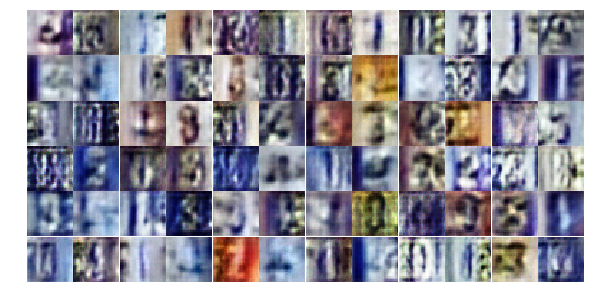

Epoch 4/25... Discriminator Loss: 0.5702... Generator Loss: 1.7302
Epoch 4/25... Discriminator Loss: 0.5668... Generator Loss: 2.2452
Epoch 4/25... Discriminator Loss: 0.3042... Generator Loss: 2.8888
Epoch 4/25... Discriminator Loss: 0.6452... Generator Loss: 2.0613
Epoch 4/25... Discriminator Loss: 0.3865... Generator Loss: 1.6567
Epoch 4/25... Discriminator Loss: 0.8595... Generator Loss: 0.8594
Epoch 4/25... Discriminator Loss: 0.5632... Generator Loss: 1.3145
Epoch 4/25... Discriminator Loss: 0.7760... Generator Loss: 0.9102
Epoch 4/25... Discriminator Loss: 0.8836... Generator Loss: 2.8567
Epoch 5/25... Discriminator Loss: 0.6676... Generator Loss: 0.9861


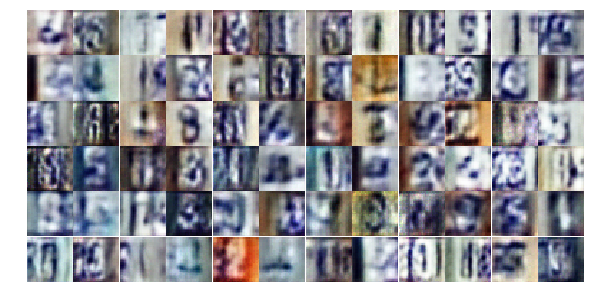

Epoch 5/25... Discriminator Loss: 0.6572... Generator Loss: 1.0691
Epoch 5/25... Discriminator Loss: 0.4828... Generator Loss: 1.3878
Epoch 5/25... Discriminator Loss: 0.7641... Generator Loss: 1.0185
Epoch 5/25... Discriminator Loss: 0.4864... Generator Loss: 1.3662
Epoch 5/25... Discriminator Loss: 0.7991... Generator Loss: 2.9633
Epoch 5/25... Discriminator Loss: 1.3457... Generator Loss: 0.4048
Epoch 5/25... Discriminator Loss: 0.6644... Generator Loss: 1.2766
Epoch 5/25... Discriminator Loss: 0.7155... Generator Loss: 0.9681
Epoch 5/25... Discriminator Loss: 0.9416... Generator Loss: 0.7036
Epoch 5/25... Discriminator Loss: 0.5958... Generator Loss: 1.2693


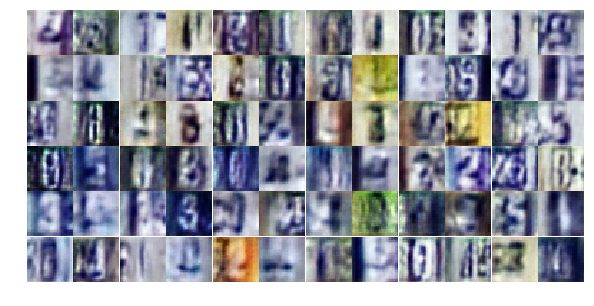

Epoch 5/25... Discriminator Loss: 0.3872... Generator Loss: 1.6248
Epoch 5/25... Discriminator Loss: 0.5044... Generator Loss: 1.7758
Epoch 5/25... Discriminator Loss: 0.5917... Generator Loss: 1.5886
Epoch 5/25... Discriminator Loss: 0.7877... Generator Loss: 0.8223
Epoch 5/25... Discriminator Loss: 0.6392... Generator Loss: 2.1607
Epoch 5/25... Discriminator Loss: 0.9598... Generator Loss: 1.7760
Epoch 5/25... Discriminator Loss: 0.6330... Generator Loss: 1.2034
Epoch 5/25... Discriminator Loss: 0.8267... Generator Loss: 0.8441
Epoch 5/25... Discriminator Loss: 0.3960... Generator Loss: 1.9422
Epoch 5/25... Discriminator Loss: 0.5893... Generator Loss: 1.2316


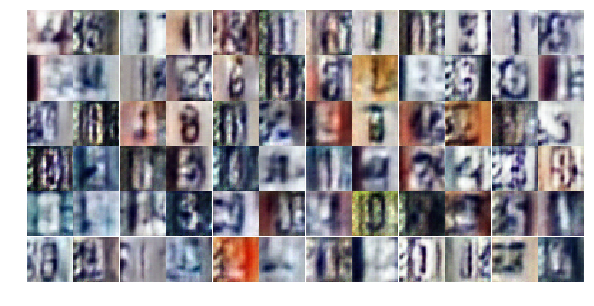

Epoch 5/25... Discriminator Loss: 0.5509... Generator Loss: 1.4690
Epoch 5/25... Discriminator Loss: 1.8038... Generator Loss: 1.1791
Epoch 5/25... Discriminator Loss: 0.5974... Generator Loss: 1.7526
Epoch 5/25... Discriminator Loss: 0.7300... Generator Loss: 1.1344
Epoch 5/25... Discriminator Loss: 0.7651... Generator Loss: 0.8433
Epoch 5/25... Discriminator Loss: 0.6091... Generator Loss: 1.1279
Epoch 5/25... Discriminator Loss: 0.5195... Generator Loss: 1.2691
Epoch 5/25... Discriminator Loss: 0.9203... Generator Loss: 0.7832
Epoch 5/25... Discriminator Loss: 0.5362... Generator Loss: 2.2386
Epoch 5/25... Discriminator Loss: 0.4197... Generator Loss: 1.6410


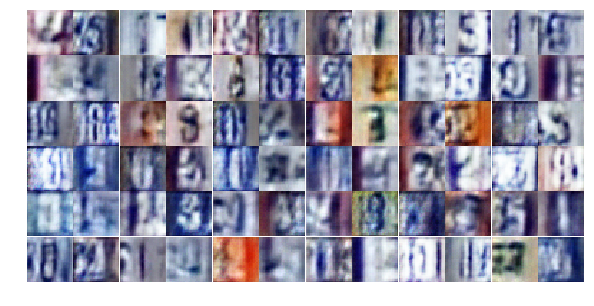

Epoch 5/25... Discriminator Loss: 0.6223... Generator Loss: 1.2859
Epoch 5/25... Discriminator Loss: 0.4949... Generator Loss: 1.4080
Epoch 5/25... Discriminator Loss: 0.5842... Generator Loss: 2.1782
Epoch 5/25... Discriminator Loss: 0.7226... Generator Loss: 0.8897
Epoch 5/25... Discriminator Loss: 0.5931... Generator Loss: 1.6070
Epoch 5/25... Discriminator Loss: 0.5099... Generator Loss: 1.6692
Epoch 5/25... Discriminator Loss: 0.5804... Generator Loss: 1.0731
Epoch 5/25... Discriminator Loss: 0.9490... Generator Loss: 0.6706
Epoch 5/25... Discriminator Loss: 0.9996... Generator Loss: 0.6220
Epoch 5/25... Discriminator Loss: 0.9098... Generator Loss: 0.7727


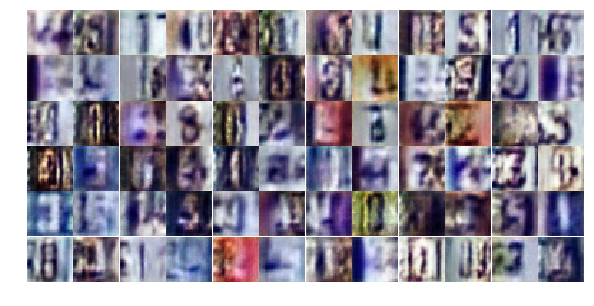

Epoch 5/25... Discriminator Loss: 0.4763... Generator Loss: 1.5995
Epoch 5/25... Discriminator Loss: 0.7449... Generator Loss: 0.8243
Epoch 5/25... Discriminator Loss: 0.9432... Generator Loss: 0.7044
Epoch 5/25... Discriminator Loss: 0.4106... Generator Loss: 2.3052
Epoch 5/25... Discriminator Loss: 1.1004... Generator Loss: 1.2589
Epoch 5/25... Discriminator Loss: 1.0494... Generator Loss: 2.7057
Epoch 5/25... Discriminator Loss: 0.5459... Generator Loss: 1.3632
Epoch 5/25... Discriminator Loss: 0.6898... Generator Loss: 1.6442
Epoch 5/25... Discriminator Loss: 0.5658... Generator Loss: 2.2958
Epoch 5/25... Discriminator Loss: 0.5719... Generator Loss: 1.9244


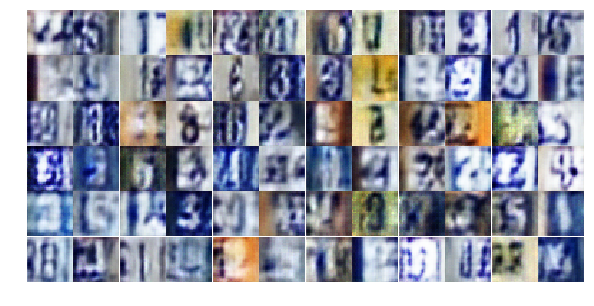

Epoch 5/25... Discriminator Loss: 1.0010... Generator Loss: 0.7579
Epoch 5/25... Discriminator Loss: 0.6295... Generator Loss: 1.1237
Epoch 5/25... Discriminator Loss: 0.7575... Generator Loss: 1.6018
Epoch 5/25... Discriminator Loss: 0.7912... Generator Loss: 0.9099
Epoch 5/25... Discriminator Loss: 0.5864... Generator Loss: 1.3978
Epoch 5/25... Discriminator Loss: 0.9085... Generator Loss: 0.8440
Epoch 6/25... Discriminator Loss: 0.5482... Generator Loss: 1.1356
Epoch 6/25... Discriminator Loss: 0.5015... Generator Loss: 1.4043
Epoch 6/25... Discriminator Loss: 0.5012... Generator Loss: 2.4031
Epoch 6/25... Discriminator Loss: 1.5980... Generator Loss: 0.3010


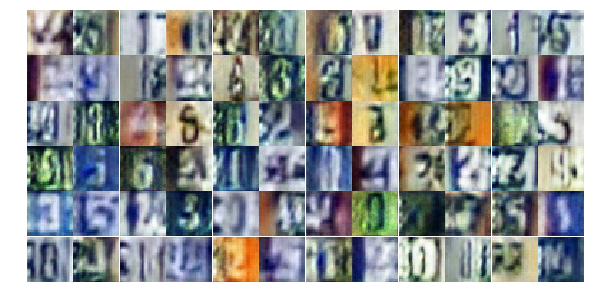

Epoch 6/25... Discriminator Loss: 0.8151... Generator Loss: 0.9064
Epoch 6/25... Discriminator Loss: 0.6193... Generator Loss: 1.5801
Epoch 6/25... Discriminator Loss: 0.6333... Generator Loss: 1.0489
Epoch 6/25... Discriminator Loss: 1.0663... Generator Loss: 0.5992
Epoch 6/25... Discriminator Loss: 1.4051... Generator Loss: 0.3867
Epoch 6/25... Discriminator Loss: 0.6008... Generator Loss: 1.0979
Epoch 6/25... Discriminator Loss: 0.5701... Generator Loss: 2.0287
Epoch 6/25... Discriminator Loss: 1.0899... Generator Loss: 0.5861
Epoch 6/25... Discriminator Loss: 0.6163... Generator Loss: 1.0779
Epoch 6/25... Discriminator Loss: 0.7682... Generator Loss: 1.8015


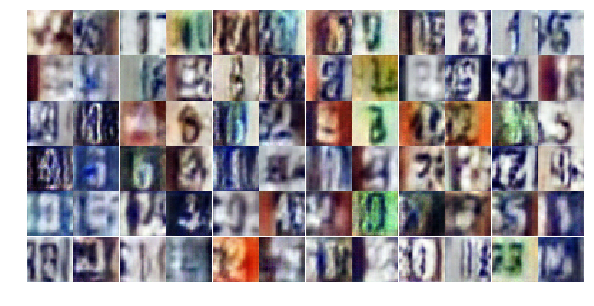

Epoch 6/25... Discriminator Loss: 0.6878... Generator Loss: 2.1320
Epoch 6/25... Discriminator Loss: 2.2739... Generator Loss: 4.2951
Epoch 6/25... Discriminator Loss: 0.7260... Generator Loss: 1.3266
Epoch 6/25... Discriminator Loss: 0.4204... Generator Loss: 1.7163
Epoch 6/25... Discriminator Loss: 0.4015... Generator Loss: 1.8825
Epoch 6/25... Discriminator Loss: 0.5139... Generator Loss: 1.4638
Epoch 6/25... Discriminator Loss: 0.4363... Generator Loss: 1.6194
Epoch 6/25... Discriminator Loss: 0.7262... Generator Loss: 0.9877
Epoch 6/25... Discriminator Loss: 0.5757... Generator Loss: 1.4339
Epoch 6/25... Discriminator Loss: 0.9350... Generator Loss: 0.8095


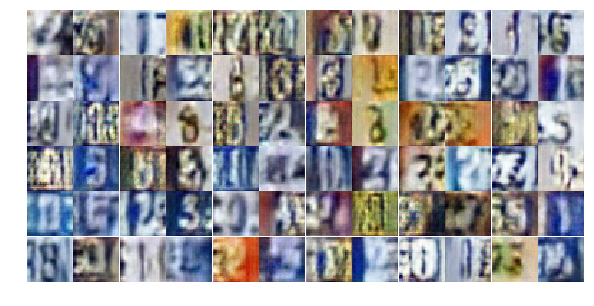

Epoch 6/25... Discriminator Loss: 0.8556... Generator Loss: 0.7423
Epoch 6/25... Discriminator Loss: 0.5714... Generator Loss: 1.1582
Epoch 6/25... Discriminator Loss: 0.9118... Generator Loss: 0.7553
Epoch 6/25... Discriminator Loss: 0.6004... Generator Loss: 1.3546
Epoch 6/25... Discriminator Loss: 0.7707... Generator Loss: 3.3207
Epoch 6/25... Discriminator Loss: 1.2973... Generator Loss: 0.4765
Epoch 6/25... Discriminator Loss: 0.6648... Generator Loss: 1.1490
Epoch 6/25... Discriminator Loss: 0.4217... Generator Loss: 1.6194
Epoch 6/25... Discriminator Loss: 0.5676... Generator Loss: 2.0294
Epoch 6/25... Discriminator Loss: 0.5083... Generator Loss: 1.4281


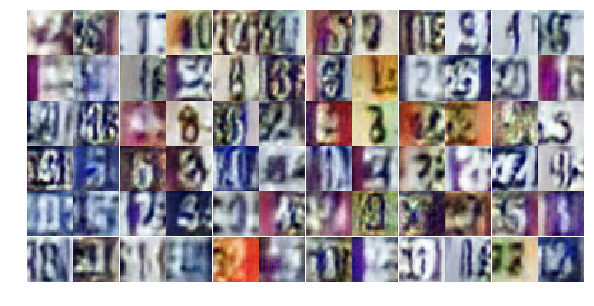

Epoch 6/25... Discriminator Loss: 1.2964... Generator Loss: 0.4732
Epoch 6/25... Discriminator Loss: 0.6850... Generator Loss: 1.0868
Epoch 6/25... Discriminator Loss: 0.9696... Generator Loss: 0.6788
Epoch 6/25... Discriminator Loss: 0.9294... Generator Loss: 0.6642
Epoch 6/25... Discriminator Loss: 0.8618... Generator Loss: 0.8031
Epoch 6/25... Discriminator Loss: 0.6826... Generator Loss: 1.0548
Epoch 6/25... Discriminator Loss: 1.3030... Generator Loss: 0.4714
Epoch 6/25... Discriminator Loss: 0.5777... Generator Loss: 1.5704
Epoch 6/25... Discriminator Loss: 0.6432... Generator Loss: 1.1014
Epoch 6/25... Discriminator Loss: 0.4743... Generator Loss: 1.5169


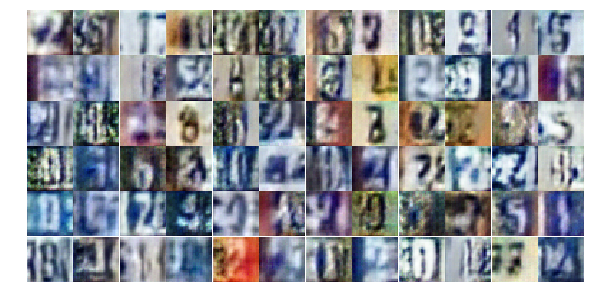

Epoch 6/25... Discriminator Loss: 2.4871... Generator Loss: 0.1531
Epoch 6/25... Discriminator Loss: 0.5670... Generator Loss: 1.9804
Epoch 6/25... Discriminator Loss: 0.8394... Generator Loss: 1.1794
Epoch 6/25... Discriminator Loss: 0.6218... Generator Loss: 1.2904
Epoch 6/25... Discriminator Loss: 0.4736... Generator Loss: 1.4936
Epoch 6/25... Discriminator Loss: 0.7356... Generator Loss: 0.9373
Epoch 6/25... Discriminator Loss: 0.6597... Generator Loss: 1.0981
Epoch 6/25... Discriminator Loss: 1.4286... Generator Loss: 0.3747
Epoch 6/25... Discriminator Loss: 0.6084... Generator Loss: 1.2865
Epoch 6/25... Discriminator Loss: 1.2215... Generator Loss: 0.4813


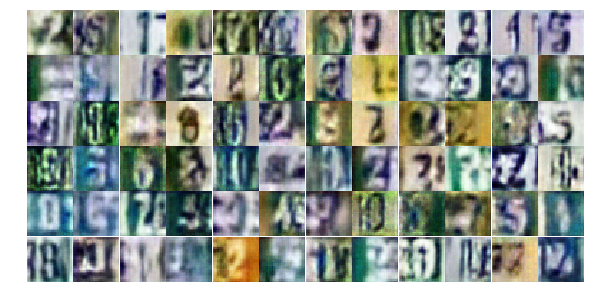

Epoch 6/25... Discriminator Loss: 0.4919... Generator Loss: 1.3348
Epoch 6/25... Discriminator Loss: 0.5267... Generator Loss: 1.2460
Epoch 6/25... Discriminator Loss: 0.6869... Generator Loss: 1.1036
Epoch 7/25... Discriminator Loss: 0.6021... Generator Loss: 2.0031
Epoch 7/25... Discriminator Loss: 0.8318... Generator Loss: 0.8408
Epoch 7/25... Discriminator Loss: 0.6006... Generator Loss: 1.2709
Epoch 7/25... Discriminator Loss: 0.4336... Generator Loss: 1.5507
Epoch 7/25... Discriminator Loss: 0.7417... Generator Loss: 1.2291
Epoch 7/25... Discriminator Loss: 0.6472... Generator Loss: 1.9304
Epoch 7/25... Discriminator Loss: 0.7922... Generator Loss: 0.9233


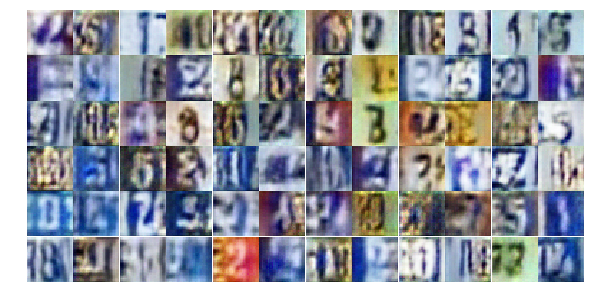

Epoch 7/25... Discriminator Loss: 0.6223... Generator Loss: 1.2455
Epoch 7/25... Discriminator Loss: 0.8881... Generator Loss: 0.7259
Epoch 7/25... Discriminator Loss: 0.8340... Generator Loss: 0.8382
Epoch 7/25... Discriminator Loss: 0.5990... Generator Loss: 1.1897
Epoch 7/25... Discriminator Loss: 0.6338... Generator Loss: 1.1462
Epoch 7/25... Discriminator Loss: 0.4240... Generator Loss: 1.5173
Epoch 7/25... Discriminator Loss: 0.7973... Generator Loss: 3.1294
Epoch 7/25... Discriminator Loss: 1.0467... Generator Loss: 3.1105
Epoch 7/25... Discriminator Loss: 1.2396... Generator Loss: 3.0780
Epoch 7/25... Discriminator Loss: 0.7502... Generator Loss: 1.0126


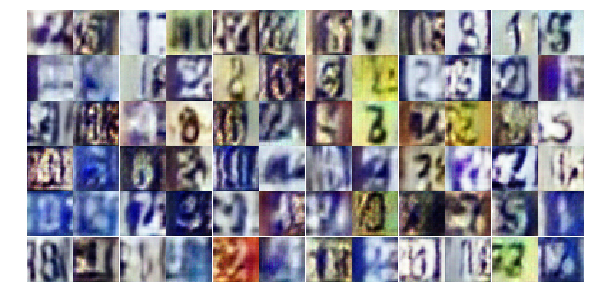

Epoch 7/25... Discriminator Loss: 0.8379... Generator Loss: 1.2650
Epoch 7/25... Discriminator Loss: 0.5876... Generator Loss: 1.3233
Epoch 7/25... Discriminator Loss: 0.8235... Generator Loss: 0.8127
Epoch 7/25... Discriminator Loss: 0.6794... Generator Loss: 1.2531
Epoch 7/25... Discriminator Loss: 0.4918... Generator Loss: 1.3351
Epoch 7/25... Discriminator Loss: 0.5582... Generator Loss: 1.1958
Epoch 7/25... Discriminator Loss: 0.7595... Generator Loss: 0.8977
Epoch 7/25... Discriminator Loss: 1.2937... Generator Loss: 0.4508
Epoch 7/25... Discriminator Loss: 0.3993... Generator Loss: 1.7292
Epoch 7/25... Discriminator Loss: 0.6874... Generator Loss: 2.7580


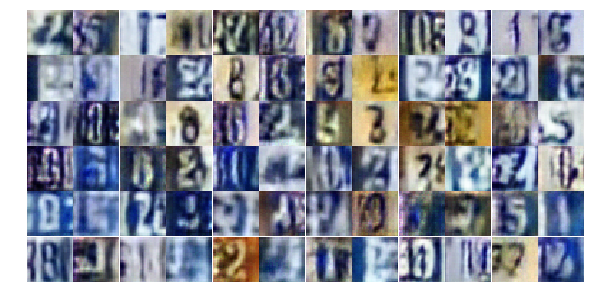

Epoch 7/25... Discriminator Loss: 1.5317... Generator Loss: 0.3496
Epoch 7/25... Discriminator Loss: 0.6924... Generator Loss: 0.9502
Epoch 7/25... Discriminator Loss: 0.6646... Generator Loss: 0.9933
Epoch 7/25... Discriminator Loss: 0.4534... Generator Loss: 1.6238
Epoch 7/25... Discriminator Loss: 0.8077... Generator Loss: 0.8715
Epoch 7/25... Discriminator Loss: 0.8871... Generator Loss: 0.8395
Epoch 7/25... Discriminator Loss: 0.6418... Generator Loss: 1.0183
Epoch 7/25... Discriminator Loss: 0.6316... Generator Loss: 1.1659
Epoch 7/25... Discriminator Loss: 1.3837... Generator Loss: 0.4085
Epoch 7/25... Discriminator Loss: 0.6460... Generator Loss: 1.7466


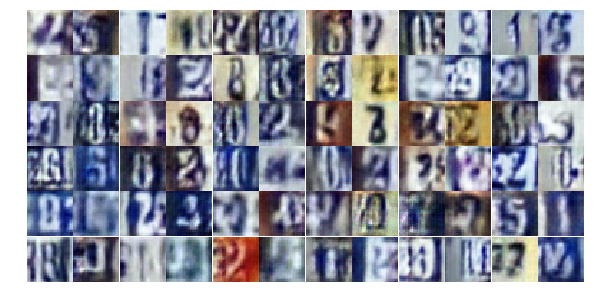

Epoch 7/25... Discriminator Loss: 0.7399... Generator Loss: 1.4063
Epoch 7/25... Discriminator Loss: 0.6766... Generator Loss: 1.1126
Epoch 7/25... Discriminator Loss: 0.6030... Generator Loss: 2.9382
Epoch 7/25... Discriminator Loss: 0.9952... Generator Loss: 0.7323
Epoch 7/25... Discriminator Loss: 0.8069... Generator Loss: 0.8167
Epoch 7/25... Discriminator Loss: 0.4853... Generator Loss: 1.3749
Epoch 7/25... Discriminator Loss: 0.6256... Generator Loss: 1.0197
Epoch 7/25... Discriminator Loss: 1.4688... Generator Loss: 0.4061
Epoch 7/25... Discriminator Loss: 0.6491... Generator Loss: 3.7718
Epoch 7/25... Discriminator Loss: 0.6879... Generator Loss: 1.2414


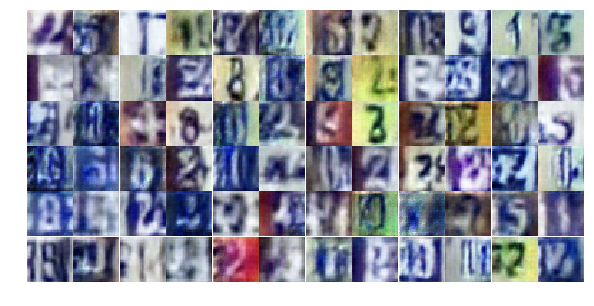

Epoch 7/25... Discriminator Loss: 0.5867... Generator Loss: 2.3055
Epoch 7/25... Discriminator Loss: 0.7931... Generator Loss: 0.8668
Epoch 7/25... Discriminator Loss: 0.9131... Generator Loss: 0.7295
Epoch 7/25... Discriminator Loss: 0.5843... Generator Loss: 1.1104
Epoch 7/25... Discriminator Loss: 0.5129... Generator Loss: 1.5923
Epoch 7/25... Discriminator Loss: 0.6258... Generator Loss: 1.1270
Epoch 7/25... Discriminator Loss: 0.7821... Generator Loss: 0.8373
Epoch 7/25... Discriminator Loss: 1.2309... Generator Loss: 0.4930
Epoch 7/25... Discriminator Loss: 0.8508... Generator Loss: 0.7930
Epoch 7/25... Discriminator Loss: 0.3738... Generator Loss: 1.7127


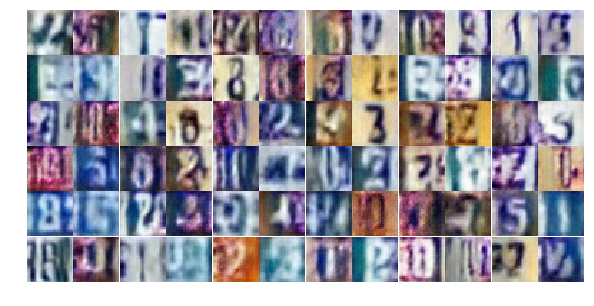

Epoch 7/25... Discriminator Loss: 0.4229... Generator Loss: 1.7402
Epoch 8/25... Discriminator Loss: 0.9638... Generator Loss: 0.6270
Epoch 8/25... Discriminator Loss: 0.5228... Generator Loss: 1.4225
Epoch 8/25... Discriminator Loss: 0.6622... Generator Loss: 1.1905
Epoch 8/25... Discriminator Loss: 1.0217... Generator Loss: 0.8949
Epoch 8/25... Discriminator Loss: 0.6787... Generator Loss: 1.4287
Epoch 8/25... Discriminator Loss: 1.0111... Generator Loss: 0.6083
Epoch 8/25... Discriminator Loss: 0.7579... Generator Loss: 1.6343
Epoch 8/25... Discriminator Loss: 0.7265... Generator Loss: 1.0871
Epoch 8/25... Discriminator Loss: 0.8067... Generator Loss: 0.8691


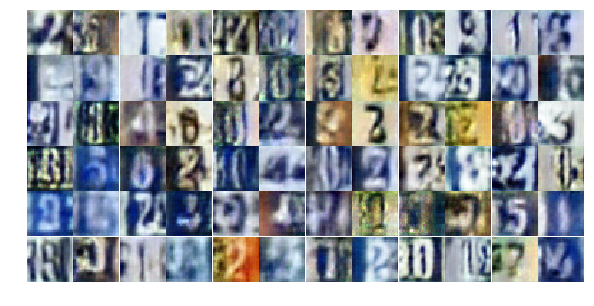

Epoch 8/25... Discriminator Loss: 0.5955... Generator Loss: 1.6015
Epoch 8/25... Discriminator Loss: 0.4425... Generator Loss: 1.5934
Epoch 8/25... Discriminator Loss: 0.7314... Generator Loss: 0.9296
Epoch 8/25... Discriminator Loss: 0.3330... Generator Loss: 1.8134
Epoch 8/25... Discriminator Loss: 0.8144... Generator Loss: 1.1440
Epoch 8/25... Discriminator Loss: 0.6494... Generator Loss: 1.1577
Epoch 8/25... Discriminator Loss: 0.4707... Generator Loss: 1.8283
Epoch 8/25... Discriminator Loss: 0.6867... Generator Loss: 1.0351
Epoch 8/25... Discriminator Loss: 0.6690... Generator Loss: 1.0814
Epoch 8/25... Discriminator Loss: 1.4956... Generator Loss: 0.3580


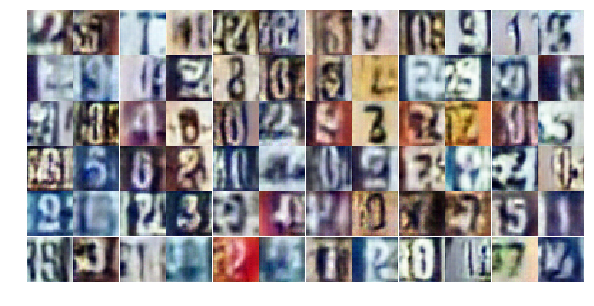

Epoch 8/25... Discriminator Loss: 0.5729... Generator Loss: 1.6805
Epoch 8/25... Discriminator Loss: 0.5548... Generator Loss: 1.2421
Epoch 8/25... Discriminator Loss: 0.7772... Generator Loss: 0.9162
Epoch 8/25... Discriminator Loss: 0.8500... Generator Loss: 0.7981
Epoch 8/25... Discriminator Loss: 0.4096... Generator Loss: 1.8453
Epoch 8/25... Discriminator Loss: 0.4692... Generator Loss: 1.6616
Epoch 8/25... Discriminator Loss: 0.6148... Generator Loss: 1.4192
Epoch 8/25... Discriminator Loss: 0.5032... Generator Loss: 1.4168
Epoch 8/25... Discriminator Loss: 0.8463... Generator Loss: 0.7633
Epoch 8/25... Discriminator Loss: 0.5991... Generator Loss: 1.3816


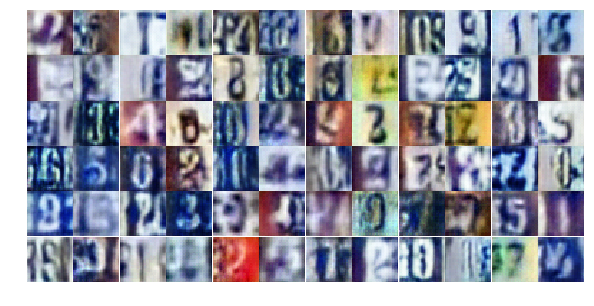

Epoch 8/25... Discriminator Loss: 0.7056... Generator Loss: 1.0547
Epoch 8/25... Discriminator Loss: 1.0628... Generator Loss: 0.6102
Epoch 8/25... Discriminator Loss: 0.7187... Generator Loss: 1.1121
Epoch 8/25... Discriminator Loss: 0.7985... Generator Loss: 0.9128
Epoch 8/25... Discriminator Loss: 1.1001... Generator Loss: 0.6268
Epoch 8/25... Discriminator Loss: 0.4417... Generator Loss: 1.5488
Epoch 8/25... Discriminator Loss: 0.6256... Generator Loss: 1.8481
Epoch 8/25... Discriminator Loss: 0.9796... Generator Loss: 0.6940
Epoch 8/25... Discriminator Loss: 0.9077... Generator Loss: 0.6805
Epoch 8/25... Discriminator Loss: 0.4706... Generator Loss: 1.3267


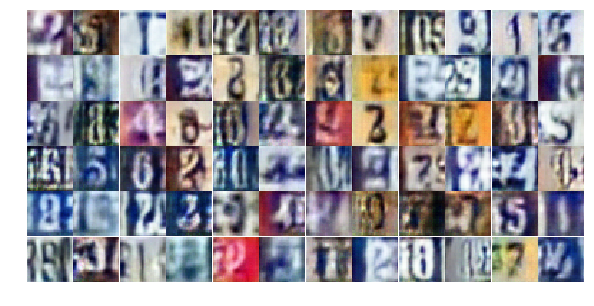

Epoch 8/25... Discriminator Loss: 0.6163... Generator Loss: 2.0229
Epoch 8/25... Discriminator Loss: 0.9361... Generator Loss: 0.7161
Epoch 8/25... Discriminator Loss: 0.6447... Generator Loss: 0.9781
Epoch 8/25... Discriminator Loss: 0.7153... Generator Loss: 1.0936
Epoch 8/25... Discriminator Loss: 0.8033... Generator Loss: 1.5781
Epoch 8/25... Discriminator Loss: 1.1640... Generator Loss: 0.4882
Epoch 8/25... Discriminator Loss: 0.6695... Generator Loss: 1.0028
Epoch 8/25... Discriminator Loss: 0.7189... Generator Loss: 1.0748
Epoch 8/25... Discriminator Loss: 0.5630... Generator Loss: 1.4731
Epoch 8/25... Discriminator Loss: 0.8126... Generator Loss: 0.8369


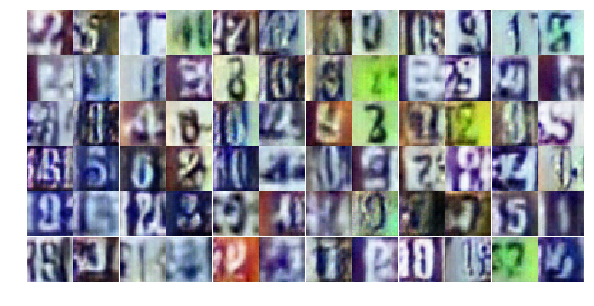

Epoch 8/25... Discriminator Loss: 0.5189... Generator Loss: 2.1523
Epoch 8/25... Discriminator Loss: 0.6285... Generator Loss: 1.1616
Epoch 8/25... Discriminator Loss: 0.5773... Generator Loss: 1.7934
Epoch 8/25... Discriminator Loss: 0.9820... Generator Loss: 0.6253
Epoch 8/25... Discriminator Loss: 0.3750... Generator Loss: 1.9633
Epoch 8/25... Discriminator Loss: 0.7211... Generator Loss: 1.4877
Epoch 8/25... Discriminator Loss: 0.6294... Generator Loss: 1.1267
Epoch 8/25... Discriminator Loss: 0.5351... Generator Loss: 1.8684
Epoch 9/25... Discriminator Loss: 0.8268... Generator Loss: 1.6396
Epoch 9/25... Discriminator Loss: 0.6650... Generator Loss: 1.0827


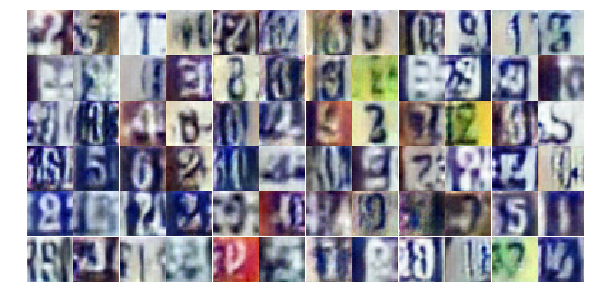

Epoch 9/25... Discriminator Loss: 0.6674... Generator Loss: 1.1140
Epoch 9/25... Discriminator Loss: 0.7376... Generator Loss: 0.9193
Epoch 9/25... Discriminator Loss: 0.7785... Generator Loss: 1.7466
Epoch 9/25... Discriminator Loss: 0.6821... Generator Loss: 1.1234
Epoch 9/25... Discriminator Loss: 0.9125... Generator Loss: 0.7966
Epoch 9/25... Discriminator Loss: 0.7784... Generator Loss: 3.5286
Epoch 9/25... Discriminator Loss: 0.8403... Generator Loss: 0.8143
Epoch 9/25... Discriminator Loss: 0.5470... Generator Loss: 1.1999
Epoch 9/25... Discriminator Loss: 0.8246... Generator Loss: 0.7849
Epoch 9/25... Discriminator Loss: 0.5809... Generator Loss: 2.0706


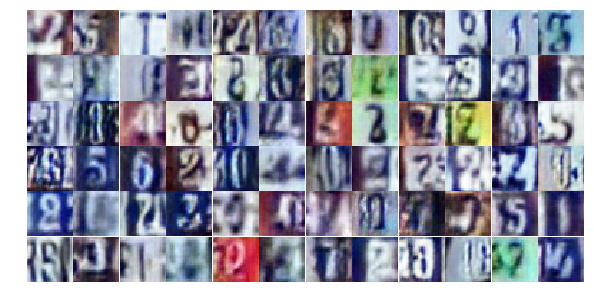

Epoch 9/25... Discriminator Loss: 1.5773... Generator Loss: 0.3422
Epoch 9/25... Discriminator Loss: 1.4850... Generator Loss: 0.3366
Epoch 9/25... Discriminator Loss: 0.7567... Generator Loss: 0.9155
Epoch 9/25... Discriminator Loss: 0.9005... Generator Loss: 0.8764
Epoch 9/25... Discriminator Loss: 0.5454... Generator Loss: 1.3309
Epoch 9/25... Discriminator Loss: 0.5799... Generator Loss: 1.5872
Epoch 9/25... Discriminator Loss: 0.9669... Generator Loss: 0.7200
Epoch 9/25... Discriminator Loss: 0.4422... Generator Loss: 1.4833
Epoch 9/25... Discriminator Loss: 1.1963... Generator Loss: 0.5065
Epoch 9/25... Discriminator Loss: 1.0157... Generator Loss: 0.5966


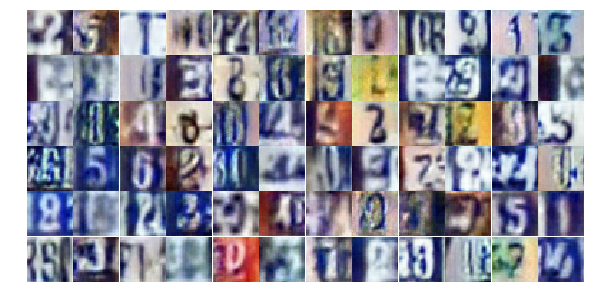

Epoch 9/25... Discriminator Loss: 0.9215... Generator Loss: 0.7246
Epoch 9/25... Discriminator Loss: 0.6111... Generator Loss: 1.4689
Epoch 9/25... Discriminator Loss: 0.5971... Generator Loss: 1.2340
Epoch 9/25... Discriminator Loss: 0.8921... Generator Loss: 0.7537
Epoch 9/25... Discriminator Loss: 1.3468... Generator Loss: 1.9277
Epoch 9/25... Discriminator Loss: 0.6524... Generator Loss: 1.1101
Epoch 9/25... Discriminator Loss: 0.6447... Generator Loss: 1.2347
Epoch 9/25... Discriminator Loss: 0.6089... Generator Loss: 1.1720
Epoch 9/25... Discriminator Loss: 0.6405... Generator Loss: 1.0564
Epoch 9/25... Discriminator Loss: 0.5102... Generator Loss: 1.2859


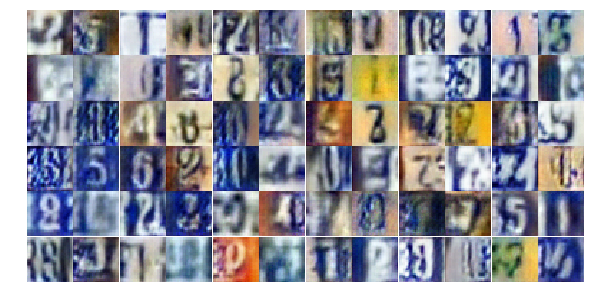

Epoch 9/25... Discriminator Loss: 0.5376... Generator Loss: 1.1850
Epoch 9/25... Discriminator Loss: 0.7068... Generator Loss: 0.9567
Epoch 9/25... Discriminator Loss: 0.7320... Generator Loss: 0.9481
Epoch 9/25... Discriminator Loss: 0.8116... Generator Loss: 0.8786
Epoch 9/25... Discriminator Loss: 0.6467... Generator Loss: 1.2423
Epoch 9/25... Discriminator Loss: 0.9135... Generator Loss: 2.3319
Epoch 9/25... Discriminator Loss: 0.6085... Generator Loss: 1.6729
Epoch 9/25... Discriminator Loss: 0.4460... Generator Loss: 1.5324
Epoch 9/25... Discriminator Loss: 0.7873... Generator Loss: 0.9527
Epoch 9/25... Discriminator Loss: 0.8030... Generator Loss: 0.7613


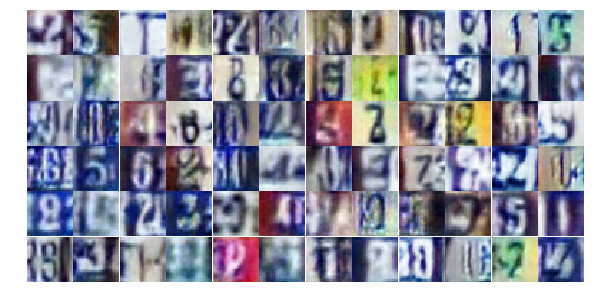

Epoch 9/25... Discriminator Loss: 0.4274... Generator Loss: 1.7715
Epoch 9/25... Discriminator Loss: 0.6936... Generator Loss: 1.1336
Epoch 9/25... Discriminator Loss: 0.4545... Generator Loss: 1.4141
Epoch 9/25... Discriminator Loss: 0.6622... Generator Loss: 1.0367
Epoch 9/25... Discriminator Loss: 0.4525... Generator Loss: 1.9607
Epoch 9/25... Discriminator Loss: 0.5889... Generator Loss: 1.1683
Epoch 9/25... Discriminator Loss: 0.5400... Generator Loss: 1.4947
Epoch 9/25... Discriminator Loss: 0.5381... Generator Loss: 1.1893
Epoch 9/25... Discriminator Loss: 1.1979... Generator Loss: 0.5225
Epoch 9/25... Discriminator Loss: 0.7957... Generator Loss: 2.2591


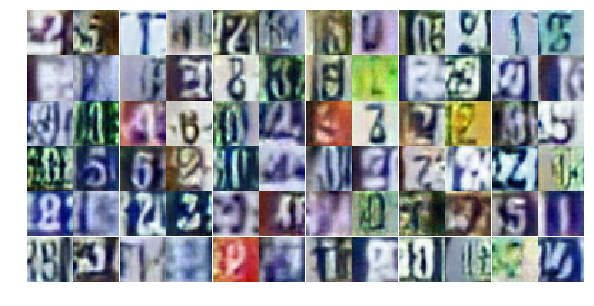

Epoch 9/25... Discriminator Loss: 1.1594... Generator Loss: 0.8381
Epoch 9/25... Discriminator Loss: 3.2914... Generator Loss: 5.3347
Epoch 9/25... Discriminator Loss: 0.9165... Generator Loss: 0.7725
Epoch 9/25... Discriminator Loss: 1.3843... Generator Loss: 0.4011
Epoch 9/25... Discriminator Loss: 0.7965... Generator Loss: 0.8840
Epoch 10/25... Discriminator Loss: 0.4868... Generator Loss: 1.6758
Epoch 10/25... Discriminator Loss: 0.6808... Generator Loss: 1.0029
Epoch 10/25... Discriminator Loss: 0.7748... Generator Loss: 0.8192
Epoch 10/25... Discriminator Loss: 0.5803... Generator Loss: 1.1336
Epoch 10/25... Discriminator Loss: 1.3984... Generator Loss: 0.4141


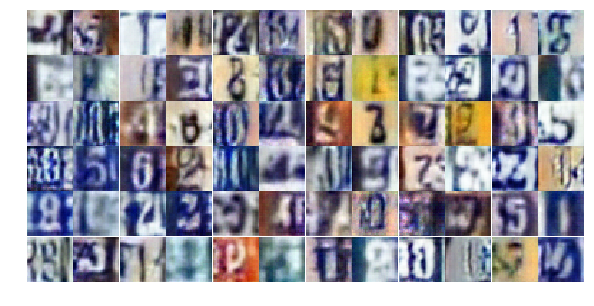

Epoch 10/25... Discriminator Loss: 0.6712... Generator Loss: 1.0040
Epoch 10/25... Discriminator Loss: 0.7624... Generator Loss: 2.8380
Epoch 10/25... Discriminator Loss: 0.7349... Generator Loss: 1.1287
Epoch 10/25... Discriminator Loss: 0.6241... Generator Loss: 1.3259
Epoch 10/25... Discriminator Loss: 0.5646... Generator Loss: 1.3813
Epoch 10/25... Discriminator Loss: 0.7452... Generator Loss: 1.1077
Epoch 10/25... Discriminator Loss: 0.6833... Generator Loss: 1.0088
Epoch 10/25... Discriminator Loss: 0.8672... Generator Loss: 0.7814
Epoch 10/25... Discriminator Loss: 0.9218... Generator Loss: 0.8714
Epoch 10/25... Discriminator Loss: 0.8934... Generator Loss: 2.1053


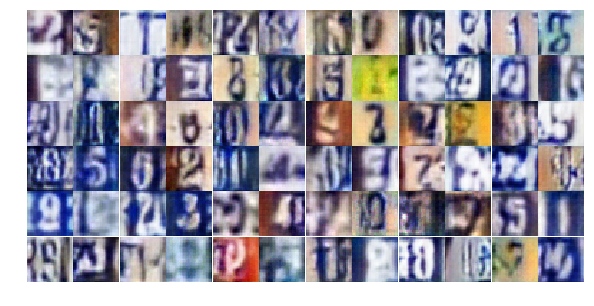

Epoch 10/25... Discriminator Loss: 0.5579... Generator Loss: 1.4879
Epoch 10/25... Discriminator Loss: 0.7175... Generator Loss: 0.9394
Epoch 10/25... Discriminator Loss: 0.8016... Generator Loss: 0.8694
Epoch 10/25... Discriminator Loss: 1.4460... Generator Loss: 0.3856
Epoch 10/25... Discriminator Loss: 0.6574... Generator Loss: 1.0730
Epoch 10/25... Discriminator Loss: 0.5648... Generator Loss: 1.2414
Epoch 10/25... Discriminator Loss: 0.6587... Generator Loss: 1.0966
Epoch 10/25... Discriminator Loss: 0.5837... Generator Loss: 1.4455
Epoch 10/25... Discriminator Loss: 0.5619... Generator Loss: 1.3602
Epoch 10/25... Discriminator Loss: 0.3331... Generator Loss: 2.2911


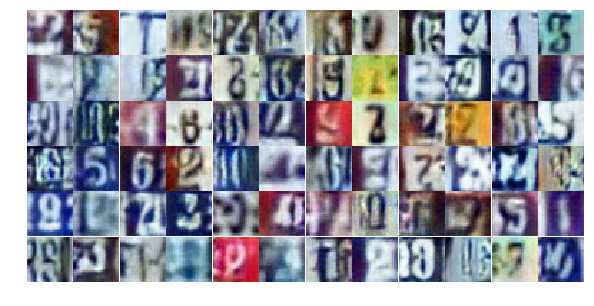

Epoch 10/25... Discriminator Loss: 0.9651... Generator Loss: 0.6331
Epoch 10/25... Discriminator Loss: 0.7709... Generator Loss: 0.9431
Epoch 10/25... Discriminator Loss: 0.3695... Generator Loss: 1.7041
Epoch 10/25... Discriminator Loss: 0.5273... Generator Loss: 1.9074
Epoch 10/25... Discriminator Loss: 1.1809... Generator Loss: 0.4861
Epoch 10/25... Discriminator Loss: 0.6159... Generator Loss: 1.1188
Epoch 10/25... Discriminator Loss: 0.4469... Generator Loss: 1.6627
Epoch 10/25... Discriminator Loss: 0.7312... Generator Loss: 0.9418
Epoch 10/25... Discriminator Loss: 0.8748... Generator Loss: 0.7601
Epoch 10/25... Discriminator Loss: 0.6362... Generator Loss: 1.2314


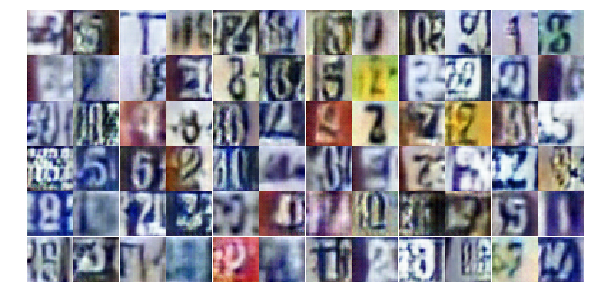

Epoch 10/25... Discriminator Loss: 0.6504... Generator Loss: 1.1972
Epoch 10/25... Discriminator Loss: 0.5771... Generator Loss: 1.5497
Epoch 10/25... Discriminator Loss: 0.5145... Generator Loss: 2.1220
Epoch 10/25... Discriminator Loss: 0.5180... Generator Loss: 1.5700
Epoch 10/25... Discriminator Loss: 0.5912... Generator Loss: 1.2707
Epoch 10/25... Discriminator Loss: 0.5955... Generator Loss: 1.1487
Epoch 10/25... Discriminator Loss: 0.7426... Generator Loss: 0.9020
Epoch 10/25... Discriminator Loss: 1.1939... Generator Loss: 0.5612
Epoch 10/25... Discriminator Loss: 0.8722... Generator Loss: 0.7523
Epoch 10/25... Discriminator Loss: 0.8524... Generator Loss: 0.8028


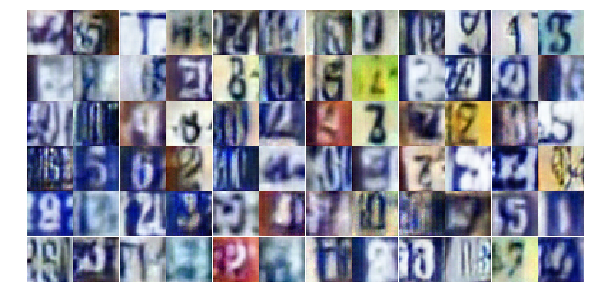

Epoch 10/25... Discriminator Loss: 0.5335... Generator Loss: 1.4239
Epoch 10/25... Discriminator Loss: 1.0533... Generator Loss: 0.6464
Epoch 10/25... Discriminator Loss: 0.7551... Generator Loss: 0.8560
Epoch 10/25... Discriminator Loss: 0.8090... Generator Loss: 0.7963
Epoch 10/25... Discriminator Loss: 0.4339... Generator Loss: 1.6128
Epoch 10/25... Discriminator Loss: 0.7912... Generator Loss: 0.9007
Epoch 10/25... Discriminator Loss: 0.6692... Generator Loss: 1.0492
Epoch 10/25... Discriminator Loss: 0.9199... Generator Loss: 2.6804
Epoch 10/25... Discriminator Loss: 1.2607... Generator Loss: 2.8221
Epoch 10/25... Discriminator Loss: 0.5685... Generator Loss: 2.0003


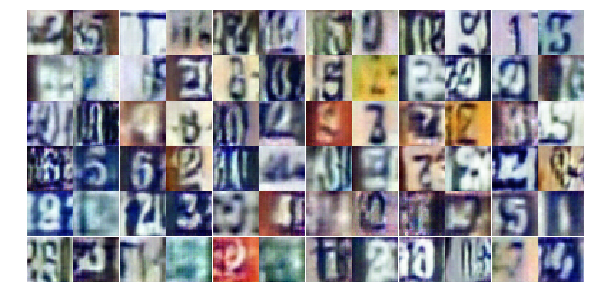

Epoch 10/25... Discriminator Loss: 1.0338... Generator Loss: 1.5209
Epoch 10/25... Discriminator Loss: 0.5621... Generator Loss: 1.2544
Epoch 10/25... Discriminator Loss: 0.4562... Generator Loss: 1.6372
Epoch 11/25... Discriminator Loss: 1.0879... Generator Loss: 0.5672
Epoch 11/25... Discriminator Loss: 0.6571... Generator Loss: 1.0862
Epoch 11/25... Discriminator Loss: 1.3855... Generator Loss: 0.3952
Epoch 11/25... Discriminator Loss: 0.7242... Generator Loss: 0.9460
Epoch 11/25... Discriminator Loss: 0.7951... Generator Loss: 1.4774
Epoch 11/25... Discriminator Loss: 1.2012... Generator Loss: 1.2587
Epoch 11/25... Discriminator Loss: 0.4259... Generator Loss: 1.7523


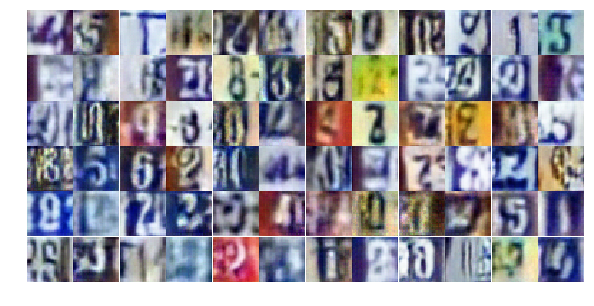

Epoch 11/25... Discriminator Loss: 0.4585... Generator Loss: 1.4945
Epoch 11/25... Discriminator Loss: 0.7376... Generator Loss: 0.9919
Epoch 11/25... Discriminator Loss: 0.3435... Generator Loss: 1.7101
Epoch 11/25... Discriminator Loss: 0.6471... Generator Loss: 1.0611
Epoch 11/25... Discriminator Loss: 0.8559... Generator Loss: 0.9159
Epoch 11/25... Discriminator Loss: 0.4000... Generator Loss: 1.7473
Epoch 11/25... Discriminator Loss: 0.6214... Generator Loss: 1.1494
Epoch 11/25... Discriminator Loss: 0.3678... Generator Loss: 2.0348
Epoch 11/25... Discriminator Loss: 0.7400... Generator Loss: 0.8912
Epoch 11/25... Discriminator Loss: 1.9772... Generator Loss: 0.2056


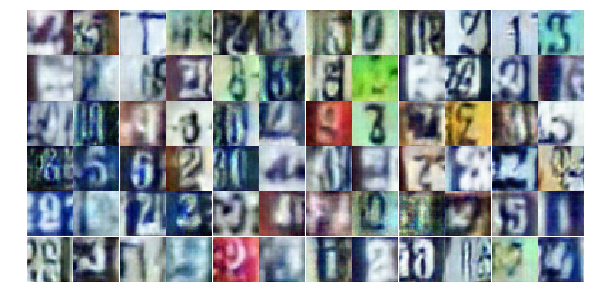

Epoch 11/25... Discriminator Loss: 1.1733... Generator Loss: 0.5522
Epoch 11/25... Discriminator Loss: 0.6988... Generator Loss: 1.6465
Epoch 11/25... Discriminator Loss: 0.7853... Generator Loss: 0.8688
Epoch 11/25... Discriminator Loss: 0.6069... Generator Loss: 1.1065
Epoch 11/25... Discriminator Loss: 0.3617... Generator Loss: 2.0255
Epoch 11/25... Discriminator Loss: 0.4524... Generator Loss: 2.4394
Epoch 11/25... Discriminator Loss: 0.5469... Generator Loss: 1.2011
Epoch 11/25... Discriminator Loss: 0.8947... Generator Loss: 0.7689
Epoch 11/25... Discriminator Loss: 0.3616... Generator Loss: 1.8152
Epoch 11/25... Discriminator Loss: 0.8235... Generator Loss: 0.7999


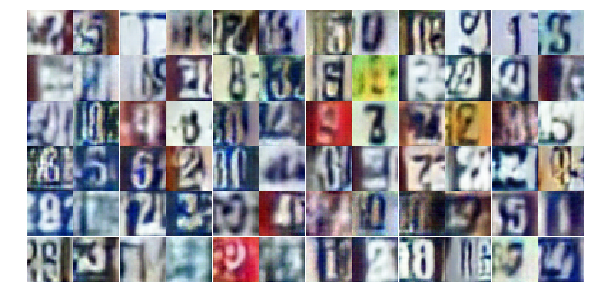

Epoch 11/25... Discriminator Loss: 0.8415... Generator Loss: 0.8254
Epoch 11/25... Discriminator Loss: 0.8280... Generator Loss: 0.7711
Epoch 11/25... Discriminator Loss: 0.7129... Generator Loss: 0.9207
Epoch 11/25... Discriminator Loss: 0.5525... Generator Loss: 1.3343
Epoch 11/25... Discriminator Loss: 0.5317... Generator Loss: 1.2748
Epoch 11/25... Discriminator Loss: 1.4897... Generator Loss: 0.3889
Epoch 11/25... Discriminator Loss: 1.1565... Generator Loss: 0.6051
Epoch 11/25... Discriminator Loss: 0.9338... Generator Loss: 0.7362
Epoch 11/25... Discriminator Loss: 0.6679... Generator Loss: 1.0879
Epoch 11/25... Discriminator Loss: 1.4898... Generator Loss: 0.3425


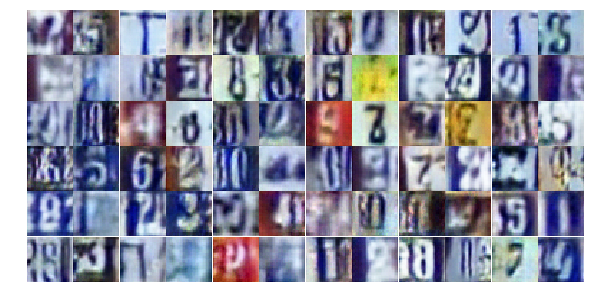

Epoch 11/25... Discriminator Loss: 0.4342... Generator Loss: 1.3990
Epoch 11/25... Discriminator Loss: 0.4824... Generator Loss: 1.5793
Epoch 11/25... Discriminator Loss: 1.7621... Generator Loss: 0.2790
Epoch 11/25... Discriminator Loss: 0.6722... Generator Loss: 1.1840
Epoch 11/25... Discriminator Loss: 0.9397... Generator Loss: 0.7047
Epoch 11/25... Discriminator Loss: 0.7579... Generator Loss: 0.8518
Epoch 11/25... Discriminator Loss: 1.8810... Generator Loss: 0.2636
Epoch 11/25... Discriminator Loss: 0.7420... Generator Loss: 0.9781
Epoch 11/25... Discriminator Loss: 1.3189... Generator Loss: 0.4063
Epoch 11/25... Discriminator Loss: 0.4913... Generator Loss: 1.4380


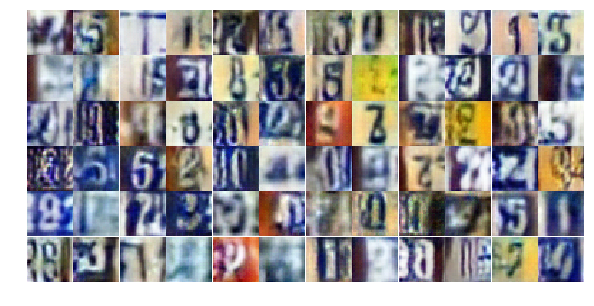

Epoch 11/25... Discriminator Loss: 0.6886... Generator Loss: 1.0270
Epoch 11/25... Discriminator Loss: 0.3849... Generator Loss: 1.6200
Epoch 11/25... Discriminator Loss: 0.5647... Generator Loss: 1.3557
Epoch 11/25... Discriminator Loss: 0.6801... Generator Loss: 0.9292
Epoch 11/25... Discriminator Loss: 1.0668... Generator Loss: 0.5612
Epoch 11/25... Discriminator Loss: 0.6487... Generator Loss: 1.1040
Epoch 11/25... Discriminator Loss: 1.4625... Generator Loss: 0.4181
Epoch 11/25... Discriminator Loss: 0.5104... Generator Loss: 2.3012
Epoch 11/25... Discriminator Loss: 0.7970... Generator Loss: 0.9369
Epoch 11/25... Discriminator Loss: 0.6484... Generator Loss: 1.1290


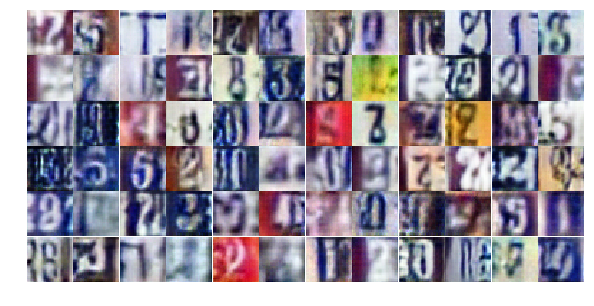

Epoch 12/25... Discriminator Loss: 0.6369... Generator Loss: 1.8613
Epoch 12/25... Discriminator Loss: 0.7289... Generator Loss: 1.7566
Epoch 12/25... Discriminator Loss: 0.8888... Generator Loss: 0.8879
Epoch 12/25... Discriminator Loss: 0.3689... Generator Loss: 1.9189
Epoch 12/25... Discriminator Loss: 0.4227... Generator Loss: 2.0225
Epoch 12/25... Discriminator Loss: 1.3942... Generator Loss: 0.3871
Epoch 12/25... Discriminator Loss: 0.7283... Generator Loss: 0.8507
Epoch 12/25... Discriminator Loss: 0.4468... Generator Loss: 1.8701
Epoch 12/25... Discriminator Loss: 0.5882... Generator Loss: 1.6629
Epoch 12/25... Discriminator Loss: 1.2297... Generator Loss: 0.4690


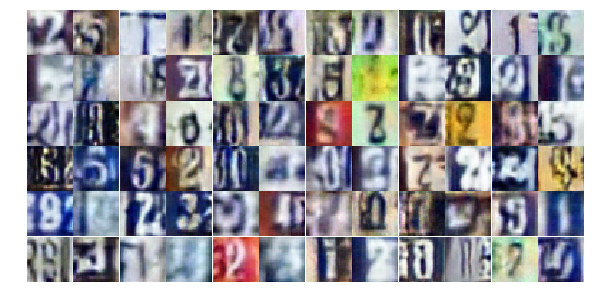

Epoch 12/25... Discriminator Loss: 0.4918... Generator Loss: 1.4098
Epoch 12/25... Discriminator Loss: 0.8314... Generator Loss: 1.4896
Epoch 12/25... Discriminator Loss: 0.5871... Generator Loss: 1.1918
Epoch 12/25... Discriminator Loss: 0.6524... Generator Loss: 1.3038
Epoch 12/25... Discriminator Loss: 0.4369... Generator Loss: 1.7892
Epoch 12/25... Discriminator Loss: 1.0329... Generator Loss: 0.6519
Epoch 12/25... Discriminator Loss: 1.4421... Generator Loss: 0.3922
Epoch 12/25... Discriminator Loss: 0.5099... Generator Loss: 1.4140
Epoch 12/25... Discriminator Loss: 0.5442... Generator Loss: 1.1833
Epoch 12/25... Discriminator Loss: 0.7006... Generator Loss: 0.9989


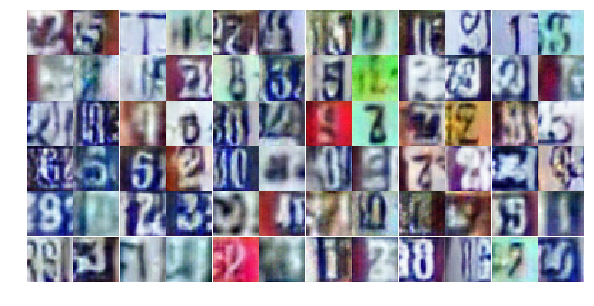

Epoch 12/25... Discriminator Loss: 0.2779... Generator Loss: 1.9582
Epoch 12/25... Discriminator Loss: 0.4391... Generator Loss: 1.7734
Epoch 12/25... Discriminator Loss: 2.2140... Generator Loss: 0.2129
Epoch 12/25... Discriminator Loss: 0.6104... Generator Loss: 1.6571
Epoch 12/25... Discriminator Loss: 0.4960... Generator Loss: 1.4782
Epoch 12/25... Discriminator Loss: 0.4887... Generator Loss: 1.4413
Epoch 12/25... Discriminator Loss: 0.6967... Generator Loss: 0.9616
Epoch 12/25... Discriminator Loss: 0.4126... Generator Loss: 1.4915
Epoch 12/25... Discriminator Loss: 0.5977... Generator Loss: 1.1891
Epoch 12/25... Discriminator Loss: 0.5792... Generator Loss: 1.1273


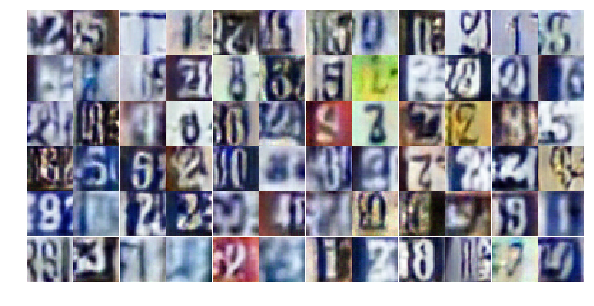

Epoch 12/25... Discriminator Loss: 0.8642... Generator Loss: 0.8049
Epoch 12/25... Discriminator Loss: 0.6702... Generator Loss: 1.7428
Epoch 12/25... Discriminator Loss: 0.9611... Generator Loss: 0.6800
Epoch 12/25... Discriminator Loss: 1.5856... Generator Loss: 0.3260
Epoch 12/25... Discriminator Loss: 1.3249... Generator Loss: 2.2630
Epoch 12/25... Discriminator Loss: 1.7287... Generator Loss: 0.3087
Epoch 12/25... Discriminator Loss: 0.9966... Generator Loss: 0.6430
Epoch 12/25... Discriminator Loss: 0.7093... Generator Loss: 1.0482
Epoch 12/25... Discriminator Loss: 0.6074... Generator Loss: 1.6269
Epoch 12/25... Discriminator Loss: 0.3910... Generator Loss: 1.6045


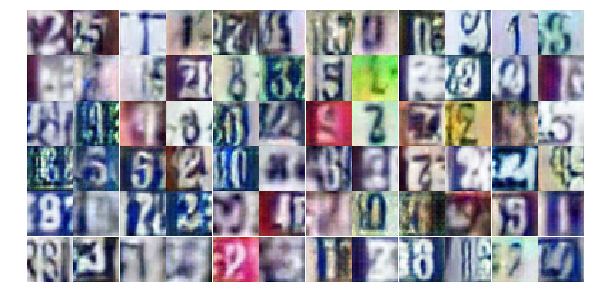

Epoch 12/25... Discriminator Loss: 0.6863... Generator Loss: 0.9396
Epoch 12/25... Discriminator Loss: 0.4381... Generator Loss: 1.5130
Epoch 12/25... Discriminator Loss: 0.4271... Generator Loss: 1.6696
Epoch 12/25... Discriminator Loss: 0.6062... Generator Loss: 1.1642
Epoch 12/25... Discriminator Loss: 0.7393... Generator Loss: 0.9408
Epoch 12/25... Discriminator Loss: 1.2694... Generator Loss: 0.4773
Epoch 12/25... Discriminator Loss: 0.6321... Generator Loss: 1.1514
Epoch 12/25... Discriminator Loss: 0.8839... Generator Loss: 0.8257
Epoch 12/25... Discriminator Loss: 0.9876... Generator Loss: 0.7632
Epoch 12/25... Discriminator Loss: 0.7022... Generator Loss: 0.9508


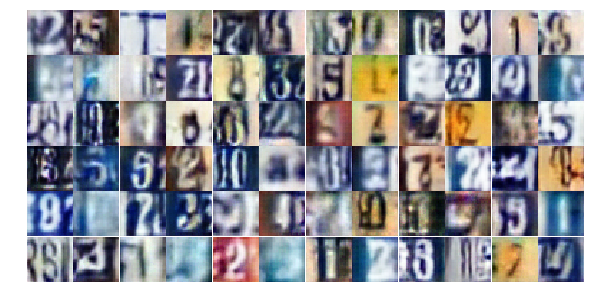

Epoch 12/25... Discriminator Loss: 0.9310... Generator Loss: 0.8273
Epoch 12/25... Discriminator Loss: 0.4509... Generator Loss: 1.6086
Epoch 12/25... Discriminator Loss: 0.7411... Generator Loss: 1.4958
Epoch 12/25... Discriminator Loss: 1.0405... Generator Loss: 0.7252
Epoch 12/25... Discriminator Loss: 0.4598... Generator Loss: 1.3320
Epoch 12/25... Discriminator Loss: 0.7045... Generator Loss: 1.2149
Epoch 12/25... Discriminator Loss: 1.2289... Generator Loss: 0.4830
Epoch 13/25... Discriminator Loss: 0.5572... Generator Loss: 1.1900
Epoch 13/25... Discriminator Loss: 0.3923... Generator Loss: 1.8348
Epoch 13/25... Discriminator Loss: 0.7497... Generator Loss: 1.2421


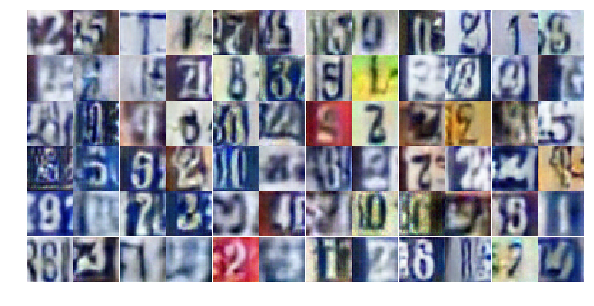

Epoch 13/25... Discriminator Loss: 0.5191... Generator Loss: 1.4342
Epoch 13/25... Discriminator Loss: 0.6387... Generator Loss: 1.1512
Epoch 13/25... Discriminator Loss: 1.0779... Generator Loss: 0.6244
Epoch 13/25... Discriminator Loss: 1.7383... Generator Loss: 0.2638
Epoch 13/25... Discriminator Loss: 0.6647... Generator Loss: 1.0886
Epoch 13/25... Discriminator Loss: 0.5275... Generator Loss: 1.4730
Epoch 13/25... Discriminator Loss: 0.4394... Generator Loss: 1.4787
Epoch 13/25... Discriminator Loss: 1.1143... Generator Loss: 0.5192
Epoch 13/25... Discriminator Loss: 0.4800... Generator Loss: 1.2882
Epoch 13/25... Discriminator Loss: 0.5956... Generator Loss: 1.1674


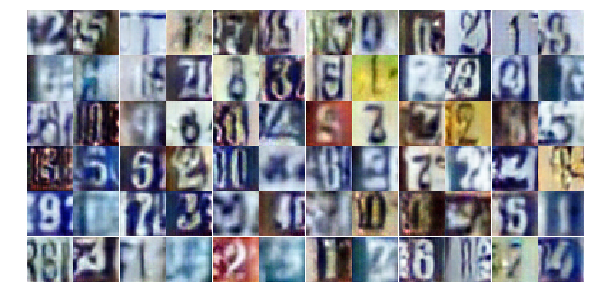

Epoch 13/25... Discriminator Loss: 1.2544... Generator Loss: 2.7234
Epoch 13/25... Discriminator Loss: 0.5725... Generator Loss: 1.2256
Epoch 13/25... Discriminator Loss: 0.6868... Generator Loss: 0.9606
Epoch 13/25... Discriminator Loss: 0.6389... Generator Loss: 1.0599
Epoch 13/25... Discriminator Loss: 0.5275... Generator Loss: 1.3414
Epoch 13/25... Discriminator Loss: 0.8643... Generator Loss: 1.0823
Epoch 13/25... Discriminator Loss: 0.6880... Generator Loss: 0.9934
Epoch 13/25... Discriminator Loss: 1.0647... Generator Loss: 0.5831
Epoch 13/25... Discriminator Loss: 0.6703... Generator Loss: 1.0416
Epoch 13/25... Discriminator Loss: 1.4863... Generator Loss: 0.3601


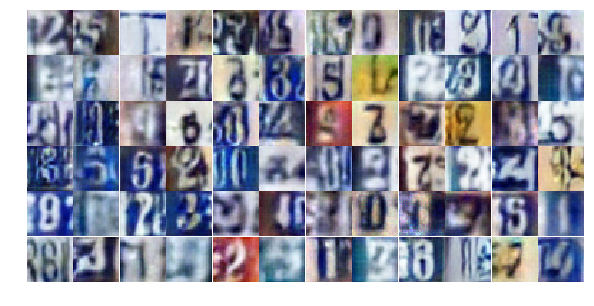

Epoch 13/25... Discriminator Loss: 0.6803... Generator Loss: 1.0239
Epoch 13/25... Discriminator Loss: 0.3492... Generator Loss: 2.4895
Epoch 13/25... Discriminator Loss: 0.4830... Generator Loss: 1.6565
Epoch 13/25... Discriminator Loss: 0.7804... Generator Loss: 0.8512
Epoch 13/25... Discriminator Loss: 1.1340... Generator Loss: 0.5663
Epoch 13/25... Discriminator Loss: 0.7935... Generator Loss: 1.1159
Epoch 13/25... Discriminator Loss: 0.9096... Generator Loss: 0.9567
Epoch 13/25... Discriminator Loss: 0.6053... Generator Loss: 1.1695
Epoch 13/25... Discriminator Loss: 0.4474... Generator Loss: 1.4790
Epoch 13/25... Discriminator Loss: 0.5528... Generator Loss: 1.2983


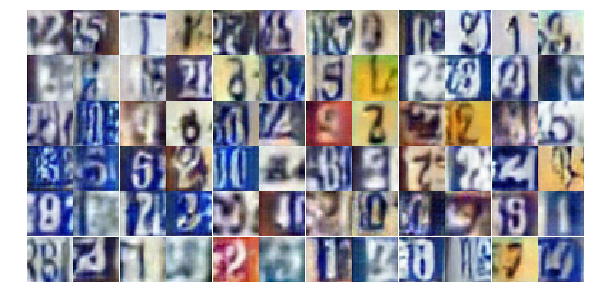

Epoch 13/25... Discriminator Loss: 1.1440... Generator Loss: 0.5215
Epoch 13/25... Discriminator Loss: 0.7360... Generator Loss: 1.1564
Epoch 13/25... Discriminator Loss: 0.8140... Generator Loss: 0.8757
Epoch 13/25... Discriminator Loss: 1.1119... Generator Loss: 0.6320
Epoch 13/25... Discriminator Loss: 0.7523... Generator Loss: 0.9618
Epoch 13/25... Discriminator Loss: 0.3267... Generator Loss: 1.8505
Epoch 13/25... Discriminator Loss: 0.5040... Generator Loss: 1.5897
Epoch 13/25... Discriminator Loss: 0.8554... Generator Loss: 1.9709
Epoch 13/25... Discriminator Loss: 0.5425... Generator Loss: 1.3726
Epoch 13/25... Discriminator Loss: 0.5264... Generator Loss: 1.3877


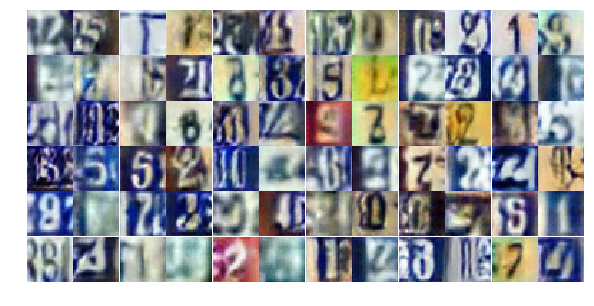

Epoch 13/25... Discriminator Loss: 0.5439... Generator Loss: 1.4171
Epoch 13/25... Discriminator Loss: 0.8909... Generator Loss: 0.8077
Epoch 13/25... Discriminator Loss: 0.8769... Generator Loss: 0.8225
Epoch 13/25... Discriminator Loss: 0.6635... Generator Loss: 1.0901
Epoch 13/25... Discriminator Loss: 1.0158... Generator Loss: 0.6720
Epoch 13/25... Discriminator Loss: 0.7225... Generator Loss: 0.8629
Epoch 13/25... Discriminator Loss: 0.8197... Generator Loss: 0.7818
Epoch 13/25... Discriminator Loss: 0.7999... Generator Loss: 0.7964
Epoch 13/25... Discriminator Loss: 0.5359... Generator Loss: 1.4602
Epoch 13/25... Discriminator Loss: 3.0915... Generator Loss: 0.1136


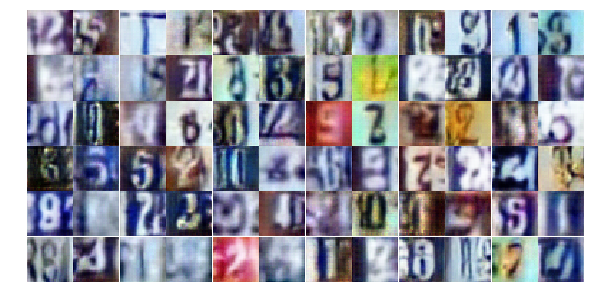

Epoch 13/25... Discriminator Loss: 0.5948... Generator Loss: 1.1877
Epoch 13/25... Discriminator Loss: 1.1883... Generator Loss: 0.5355
Epoch 13/25... Discriminator Loss: 0.7705... Generator Loss: 1.0343
Epoch 13/25... Discriminator Loss: 0.7852... Generator Loss: 0.8454
Epoch 14/25... Discriminator Loss: 0.8664... Generator Loss: 0.7896
Epoch 14/25... Discriminator Loss: 0.6371... Generator Loss: 1.9736
Epoch 14/25... Discriminator Loss: 0.8190... Generator Loss: 0.9328
Epoch 14/25... Discriminator Loss: 0.5576... Generator Loss: 2.0412
Epoch 14/25... Discriminator Loss: 0.6157... Generator Loss: 1.1919
Epoch 14/25... Discriminator Loss: 0.7405... Generator Loss: 0.8768


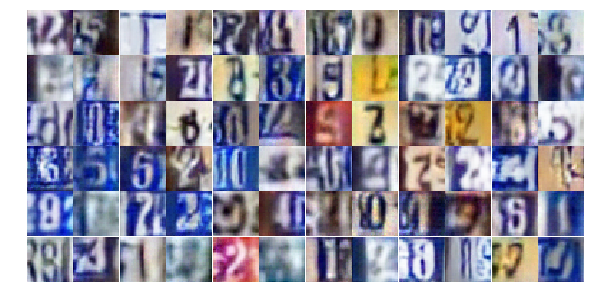

Epoch 14/25... Discriminator Loss: 0.7219... Generator Loss: 2.1161
Epoch 14/25... Discriminator Loss: 0.6406... Generator Loss: 0.9963
Epoch 14/25... Discriminator Loss: 0.6655... Generator Loss: 1.1934
Epoch 14/25... Discriminator Loss: 0.7343... Generator Loss: 1.2426
Epoch 14/25... Discriminator Loss: 1.1588... Generator Loss: 0.5200
Epoch 14/25... Discriminator Loss: 0.4135... Generator Loss: 1.5385
Epoch 14/25... Discriminator Loss: 0.3761... Generator Loss: 2.2142
Epoch 14/25... Discriminator Loss: 1.3455... Generator Loss: 0.4100
Epoch 14/25... Discriminator Loss: 0.9851... Generator Loss: 0.6211
Epoch 14/25... Discriminator Loss: 1.2497... Generator Loss: 0.4903


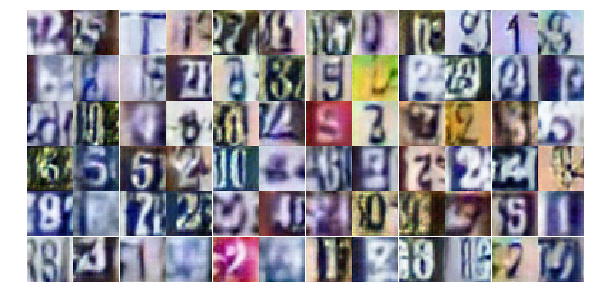

Epoch 14/25... Discriminator Loss: 0.5605... Generator Loss: 1.0705
Epoch 14/25... Discriminator Loss: 0.9849... Generator Loss: 3.6353
Epoch 14/25... Discriminator Loss: 0.9779... Generator Loss: 0.8003
Epoch 14/25... Discriminator Loss: 0.5538... Generator Loss: 1.3366
Epoch 14/25... Discriminator Loss: 0.8913... Generator Loss: 0.7451
Epoch 14/25... Discriminator Loss: 0.7768... Generator Loss: 1.1676
Epoch 14/25... Discriminator Loss: 0.7368... Generator Loss: 0.9478
Epoch 14/25... Discriminator Loss: 0.8159... Generator Loss: 0.8711
Epoch 14/25... Discriminator Loss: 0.7124... Generator Loss: 0.9682
Epoch 14/25... Discriminator Loss: 0.6249... Generator Loss: 1.2511


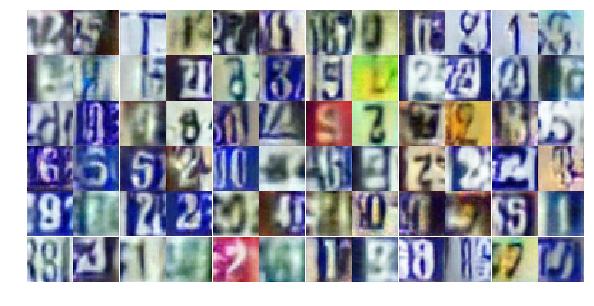

Epoch 14/25... Discriminator Loss: 1.0476... Generator Loss: 0.6142
Epoch 14/25... Discriminator Loss: 0.4531... Generator Loss: 1.4380
Epoch 14/25... Discriminator Loss: 0.5164... Generator Loss: 1.2897
Epoch 14/25... Discriminator Loss: 0.3553... Generator Loss: 1.8194
Epoch 14/25... Discriminator Loss: 0.4466... Generator Loss: 1.4877
Epoch 14/25... Discriminator Loss: 0.8775... Generator Loss: 0.7580
Epoch 14/25... Discriminator Loss: 0.6827... Generator Loss: 1.1528
Epoch 14/25... Discriminator Loss: 0.4931... Generator Loss: 1.2719
Epoch 14/25... Discriminator Loss: 0.4152... Generator Loss: 2.3864
Epoch 14/25... Discriminator Loss: 0.8069... Generator Loss: 1.1333


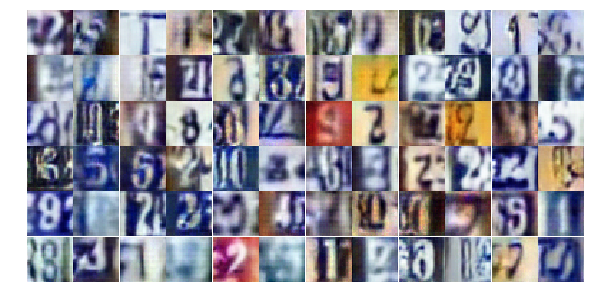

Epoch 14/25... Discriminator Loss: 1.4014... Generator Loss: 0.3717
Epoch 14/25... Discriminator Loss: 0.7649... Generator Loss: 1.2752
Epoch 14/25... Discriminator Loss: 0.7715... Generator Loss: 0.9082
Epoch 14/25... Discriminator Loss: 0.9711... Generator Loss: 0.6860
Epoch 14/25... Discriminator Loss: 0.9503... Generator Loss: 0.6776
Epoch 14/25... Discriminator Loss: 0.6855... Generator Loss: 1.0613
Epoch 14/25... Discriminator Loss: 0.5871... Generator Loss: 1.4027
Epoch 14/25... Discriminator Loss: 0.5966... Generator Loss: 1.1679
Epoch 14/25... Discriminator Loss: 1.1086... Generator Loss: 0.6526
Epoch 14/25... Discriminator Loss: 1.3223... Generator Loss: 0.4231


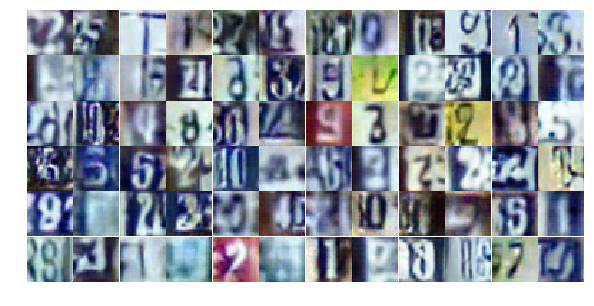

Epoch 14/25... Discriminator Loss: 1.1965... Generator Loss: 2.6371
Epoch 14/25... Discriminator Loss: 1.5594... Generator Loss: 0.3739
Epoch 14/25... Discriminator Loss: 0.6573... Generator Loss: 1.0959
Epoch 14/25... Discriminator Loss: 0.9957... Generator Loss: 0.6802
Epoch 14/25... Discriminator Loss: 0.8034... Generator Loss: 0.8260
Epoch 14/25... Discriminator Loss: 0.8829... Generator Loss: 0.8220
Epoch 14/25... Discriminator Loss: 0.5855... Generator Loss: 1.6455
Epoch 14/25... Discriminator Loss: 0.7819... Generator Loss: 0.9409
Epoch 14/25... Discriminator Loss: 0.8363... Generator Loss: 1.1125
Epoch 14/25... Discriminator Loss: 1.3019... Generator Loss: 0.4796


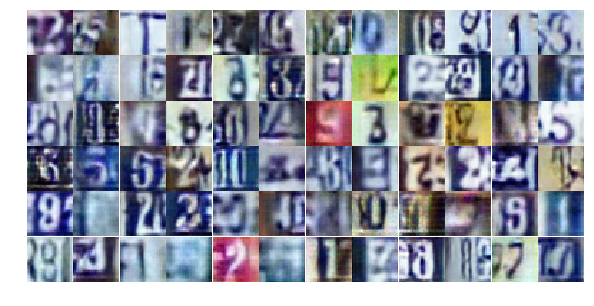

Epoch 14/25... Discriminator Loss: 0.6831... Generator Loss: 1.1435
Epoch 14/25... Discriminator Loss: 0.6456... Generator Loss: 1.3166
Epoch 15/25... Discriminator Loss: 0.5115... Generator Loss: 1.2699
Epoch 15/25... Discriminator Loss: 0.5072... Generator Loss: 1.5400
Epoch 15/25... Discriminator Loss: 0.5955... Generator Loss: 1.6126
Epoch 15/25... Discriminator Loss: 1.0622... Generator Loss: 0.5866
Epoch 15/25... Discriminator Loss: 0.8493... Generator Loss: 0.7438
Epoch 15/25... Discriminator Loss: 0.5722... Generator Loss: 1.1005
Epoch 15/25... Discriminator Loss: 1.5906... Generator Loss: 0.3093
Epoch 15/25... Discriminator Loss: 0.4939... Generator Loss: 1.3806


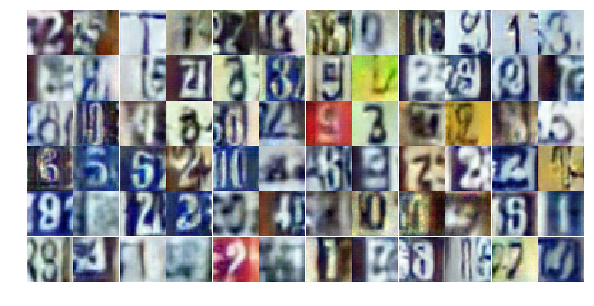

Epoch 15/25... Discriminator Loss: 1.0743... Generator Loss: 0.5981
Epoch 15/25... Discriminator Loss: 0.7933... Generator Loss: 0.9420
Epoch 15/25... Discriminator Loss: 0.8222... Generator Loss: 0.8224
Epoch 15/25... Discriminator Loss: 0.5964... Generator Loss: 1.2681
Epoch 15/25... Discriminator Loss: 0.9755... Generator Loss: 0.6723
Epoch 15/25... Discriminator Loss: 0.6713... Generator Loss: 1.1274
Epoch 15/25... Discriminator Loss: 1.8225... Generator Loss: 0.2481
Epoch 15/25... Discriminator Loss: 1.5379... Generator Loss: 0.4040
Epoch 15/25... Discriminator Loss: 0.8568... Generator Loss: 2.6178
Epoch 15/25... Discriminator Loss: 1.2751... Generator Loss: 0.4862


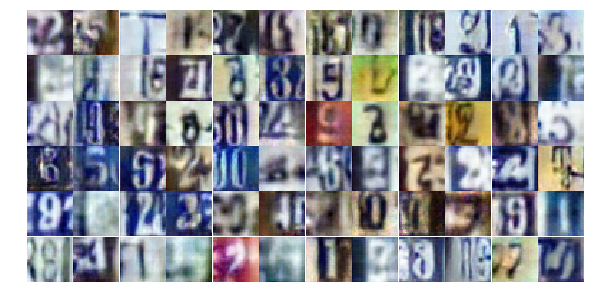

Epoch 15/25... Discriminator Loss: 1.1915... Generator Loss: 1.0444
Epoch 15/25... Discriminator Loss: 0.5685... Generator Loss: 1.2004
Epoch 15/25... Discriminator Loss: 0.5581... Generator Loss: 1.3773
Epoch 15/25... Discriminator Loss: 0.7691... Generator Loss: 0.9448
Epoch 15/25... Discriminator Loss: 1.3455... Generator Loss: 0.4706
Epoch 15/25... Discriminator Loss: 0.3763... Generator Loss: 1.7128
Epoch 15/25... Discriminator Loss: 1.1836... Generator Loss: 0.6855
Epoch 15/25... Discriminator Loss: 0.7433... Generator Loss: 0.8702
Epoch 15/25... Discriminator Loss: 0.6053... Generator Loss: 1.1067
Epoch 15/25... Discriminator Loss: 1.6372... Generator Loss: 0.3280


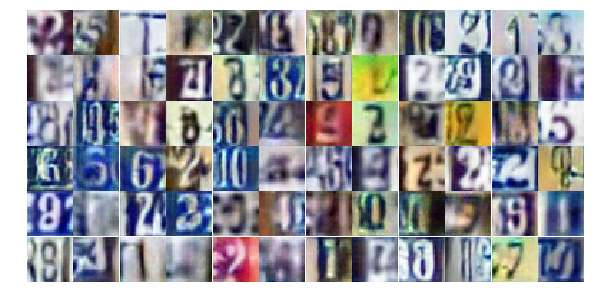

Epoch 15/25... Discriminator Loss: 0.9000... Generator Loss: 0.7286
Epoch 15/25... Discriminator Loss: 1.3267... Generator Loss: 0.4429
Epoch 15/25... Discriminator Loss: 0.4513... Generator Loss: 1.7093
Epoch 15/25... Discriminator Loss: 0.6992... Generator Loss: 1.1055
Epoch 15/25... Discriminator Loss: 0.5591... Generator Loss: 1.1887
Epoch 15/25... Discriminator Loss: 1.1831... Generator Loss: 2.6736
Epoch 15/25... Discriminator Loss: 0.5958... Generator Loss: 2.2447
Epoch 15/25... Discriminator Loss: 0.6758... Generator Loss: 1.0556
Epoch 15/25... Discriminator Loss: 0.6543... Generator Loss: 1.0091
Epoch 15/25... Discriminator Loss: 0.7569... Generator Loss: 1.5860


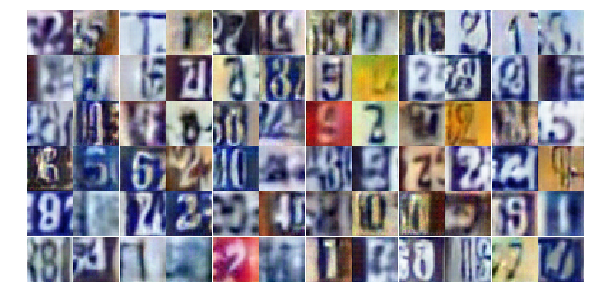

Epoch 15/25... Discriminator Loss: 0.5637... Generator Loss: 1.1666
Epoch 15/25... Discriminator Loss: 1.0269... Generator Loss: 0.6297
Epoch 15/25... Discriminator Loss: 1.4954... Generator Loss: 0.3580
Epoch 15/25... Discriminator Loss: 0.6003... Generator Loss: 1.1441
Epoch 15/25... Discriminator Loss: 0.4491... Generator Loss: 1.4948
Epoch 15/25... Discriminator Loss: 1.7493... Generator Loss: 0.2742
Epoch 15/25... Discriminator Loss: 0.5415... Generator Loss: 1.3383
Epoch 15/25... Discriminator Loss: 0.6879... Generator Loss: 1.6755
Epoch 15/25... Discriminator Loss: 1.1877... Generator Loss: 0.5168
Epoch 15/25... Discriminator Loss: 0.8897... Generator Loss: 0.9592


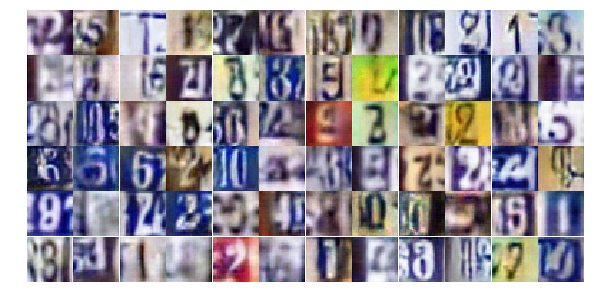

Epoch 15/25... Discriminator Loss: 1.4877... Generator Loss: 0.3439
Epoch 15/25... Discriminator Loss: 0.9107... Generator Loss: 0.7312
Epoch 15/25... Discriminator Loss: 0.5732... Generator Loss: 1.1820
Epoch 15/25... Discriminator Loss: 1.2063... Generator Loss: 0.5235
Epoch 15/25... Discriminator Loss: 0.6058... Generator Loss: 1.0563
Epoch 15/25... Discriminator Loss: 3.4634... Generator Loss: 4.5121
Epoch 15/25... Discriminator Loss: 1.0460... Generator Loss: 0.8865
Epoch 15/25... Discriminator Loss: 0.7668... Generator Loss: 1.1212
Epoch 15/25... Discriminator Loss: 1.5835... Generator Loss: 0.3066
Epoch 16/25... Discriminator Loss: 1.5085... Generator Loss: 0.3394


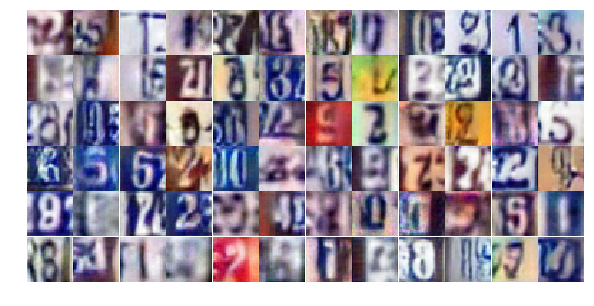

Epoch 16/25... Discriminator Loss: 0.6187... Generator Loss: 1.0796
Epoch 16/25... Discriminator Loss: 0.6369... Generator Loss: 1.2097
Epoch 16/25... Discriminator Loss: 0.8902... Generator Loss: 0.7443
Epoch 16/25... Discriminator Loss: 0.6028... Generator Loss: 1.1895
Epoch 16/25... Discriminator Loss: 0.9036... Generator Loss: 2.6169
Epoch 16/25... Discriminator Loss: 0.7189... Generator Loss: 0.9708
Epoch 16/25... Discriminator Loss: 1.4314... Generator Loss: 0.4163
Epoch 16/25... Discriminator Loss: 0.9962... Generator Loss: 0.6629
Epoch 16/25... Discriminator Loss: 0.4019... Generator Loss: 1.5905
Epoch 16/25... Discriminator Loss: 0.5749... Generator Loss: 1.2718


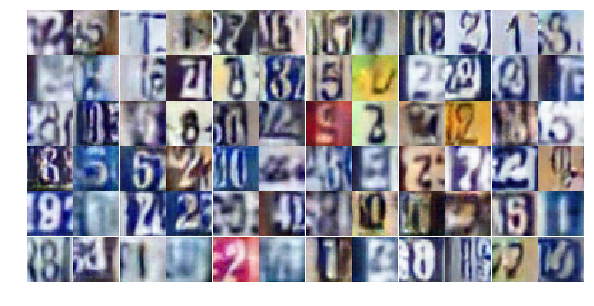

Epoch 16/25... Discriminator Loss: 1.3270... Generator Loss: 0.4468
Epoch 16/25... Discriminator Loss: 0.7882... Generator Loss: 0.9511
Epoch 16/25... Discriminator Loss: 0.8699... Generator Loss: 0.7775
Epoch 16/25... Discriminator Loss: 1.6618... Generator Loss: 0.2787
Epoch 16/25... Discriminator Loss: 0.5605... Generator Loss: 1.1289
Epoch 16/25... Discriminator Loss: 0.9511... Generator Loss: 0.6419
Epoch 16/25... Discriminator Loss: 1.0434... Generator Loss: 0.6883
Epoch 16/25... Discriminator Loss: 0.4688... Generator Loss: 1.3835
Epoch 16/25... Discriminator Loss: 0.5887... Generator Loss: 1.0773
Epoch 16/25... Discriminator Loss: 0.5082... Generator Loss: 1.3719


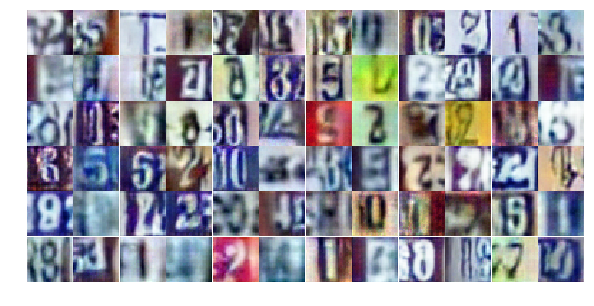

Epoch 16/25... Discriminator Loss: 0.7277... Generator Loss: 0.9994
Epoch 16/25... Discriminator Loss: 0.5907... Generator Loss: 1.4337
Epoch 16/25... Discriminator Loss: 0.7367... Generator Loss: 1.0263
Epoch 16/25... Discriminator Loss: 1.3071... Generator Loss: 0.4586
Epoch 16/25... Discriminator Loss: 1.1974... Generator Loss: 0.5404
Epoch 16/25... Discriminator Loss: 0.7190... Generator Loss: 1.0052
Epoch 16/25... Discriminator Loss: 0.9742... Generator Loss: 0.7234
Epoch 16/25... Discriminator Loss: 0.6616... Generator Loss: 1.0993
Epoch 16/25... Discriminator Loss: 1.1463... Generator Loss: 0.5402
Epoch 16/25... Discriminator Loss: 0.5972... Generator Loss: 1.1632


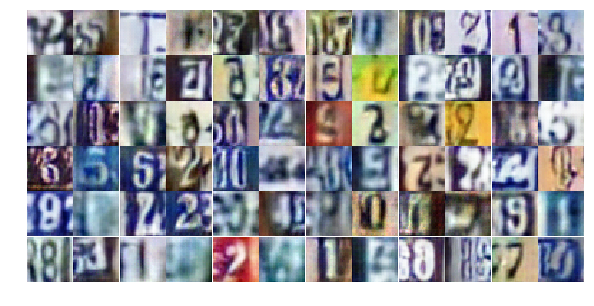

Epoch 16/25... Discriminator Loss: 0.4908... Generator Loss: 1.2352
Epoch 16/25... Discriminator Loss: 0.6267... Generator Loss: 1.0676
Epoch 16/25... Discriminator Loss: 0.5812... Generator Loss: 1.2375
Epoch 16/25... Discriminator Loss: 0.5825... Generator Loss: 1.2434
Epoch 16/25... Discriminator Loss: 0.8994... Generator Loss: 0.8560
Epoch 16/25... Discriminator Loss: 0.5409... Generator Loss: 1.5808
Epoch 16/25... Discriminator Loss: 1.0379... Generator Loss: 0.6319
Epoch 16/25... Discriminator Loss: 0.8608... Generator Loss: 0.7255
Epoch 16/25... Discriminator Loss: 0.6938... Generator Loss: 1.3374
Epoch 16/25... Discriminator Loss: 0.5859... Generator Loss: 1.2023


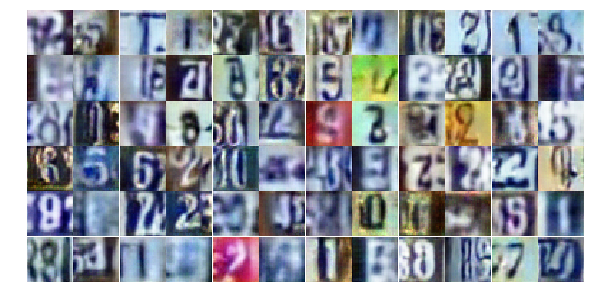

Epoch 16/25... Discriminator Loss: 0.5572... Generator Loss: 1.2419
Epoch 16/25... Discriminator Loss: 0.5041... Generator Loss: 1.3304
Epoch 16/25... Discriminator Loss: 1.2527... Generator Loss: 0.4787
Epoch 16/25... Discriminator Loss: 1.5371... Generator Loss: 0.6633
Epoch 16/25... Discriminator Loss: 0.7936... Generator Loss: 1.2586
Epoch 16/25... Discriminator Loss: 0.8460... Generator Loss: 0.8510
Epoch 16/25... Discriminator Loss: 0.4705... Generator Loss: 1.5420
Epoch 16/25... Discriminator Loss: 0.7639... Generator Loss: 1.7037
Epoch 16/25... Discriminator Loss: 0.8360... Generator Loss: 0.7350
Epoch 16/25... Discriminator Loss: 0.8373... Generator Loss: 0.8097


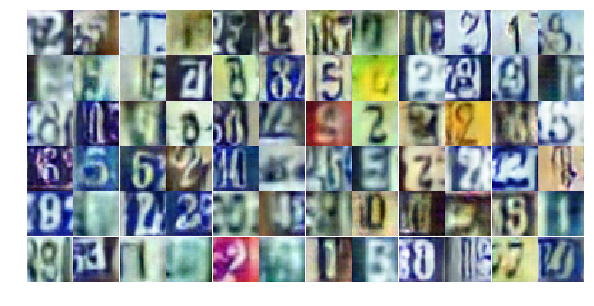

Epoch 16/25... Discriminator Loss: 1.0615... Generator Loss: 0.6671
Epoch 16/25... Discriminator Loss: 0.7190... Generator Loss: 1.0667
Epoch 16/25... Discriminator Loss: 1.8978... Generator Loss: 0.2778
Epoch 16/25... Discriminator Loss: 0.3880... Generator Loss: 2.0242
Epoch 16/25... Discriminator Loss: 0.4030... Generator Loss: 1.6908
Epoch 16/25... Discriminator Loss: 0.7180... Generator Loss: 0.9933
Epoch 17/25... Discriminator Loss: 0.6591... Generator Loss: 1.2177
Epoch 17/25... Discriminator Loss: 0.8966... Generator Loss: 0.7065
Epoch 17/25... Discriminator Loss: 0.6429... Generator Loss: 1.0340
Epoch 17/25... Discriminator Loss: 0.6705... Generator Loss: 1.0418


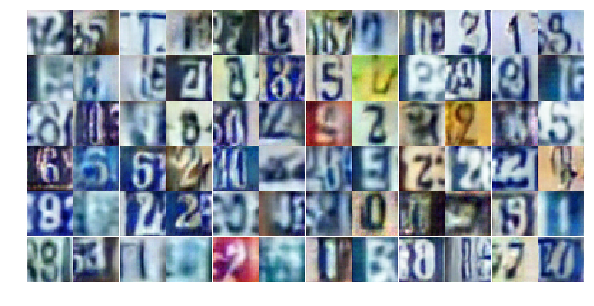

Epoch 17/25... Discriminator Loss: 0.6338... Generator Loss: 1.0737
Epoch 17/25... Discriminator Loss: 0.6455... Generator Loss: 1.1907
Epoch 17/25... Discriminator Loss: 0.7411... Generator Loss: 1.2233
Epoch 17/25... Discriminator Loss: 0.7813... Generator Loss: 0.9317
Epoch 17/25... Discriminator Loss: 1.0853... Generator Loss: 0.6192
Epoch 17/25... Discriminator Loss: 0.7942... Generator Loss: 0.9665
Epoch 17/25... Discriminator Loss: 0.8452... Generator Loss: 0.8427
Epoch 17/25... Discriminator Loss: 0.9523... Generator Loss: 0.7321
Epoch 17/25... Discriminator Loss: 0.4987... Generator Loss: 1.4730
Epoch 17/25... Discriminator Loss: 0.6151... Generator Loss: 1.7689


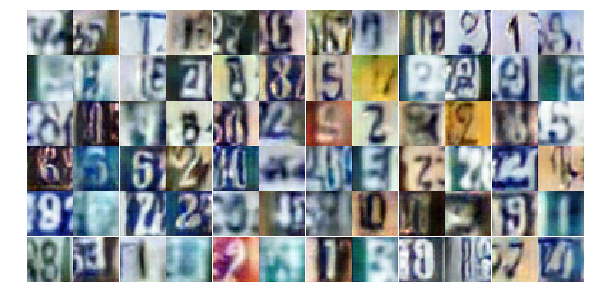

Epoch 17/25... Discriminator Loss: 0.9823... Generator Loss: 2.3917
Epoch 17/25... Discriminator Loss: 0.8559... Generator Loss: 2.6734
Epoch 17/25... Discriminator Loss: 0.5670... Generator Loss: 1.4109
Epoch 17/25... Discriminator Loss: 0.7734... Generator Loss: 0.9548
Epoch 17/25... Discriminator Loss: 0.6223... Generator Loss: 1.0216
Epoch 17/25... Discriminator Loss: 0.8421... Generator Loss: 0.7848
Epoch 17/25... Discriminator Loss: 0.6194... Generator Loss: 1.2474
Epoch 17/25... Discriminator Loss: 0.5023... Generator Loss: 1.4605
Epoch 17/25... Discriminator Loss: 0.6822... Generator Loss: 0.9697
Epoch 17/25... Discriminator Loss: 0.4899... Generator Loss: 1.2308


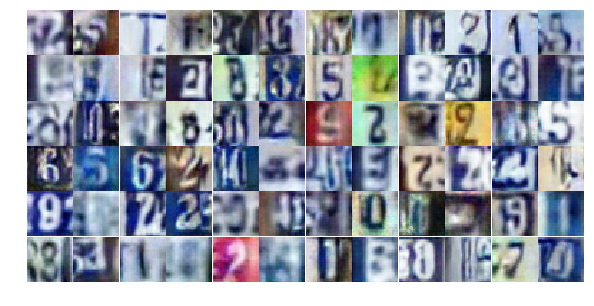

Epoch 17/25... Discriminator Loss: 1.9063... Generator Loss: 0.2419
Epoch 17/25... Discriminator Loss: 0.5467... Generator Loss: 1.3075
Epoch 17/25... Discriminator Loss: 0.4029... Generator Loss: 1.5825
Epoch 17/25... Discriminator Loss: 0.9312... Generator Loss: 0.7408
Epoch 17/25... Discriminator Loss: 1.6772... Generator Loss: 0.3158
Epoch 17/25... Discriminator Loss: 0.7234... Generator Loss: 0.9215
Epoch 17/25... Discriminator Loss: 0.8142... Generator Loss: 0.8410
Epoch 17/25... Discriminator Loss: 1.0458... Generator Loss: 0.5870
Epoch 17/25... Discriminator Loss: 0.6113... Generator Loss: 1.1364
Epoch 17/25... Discriminator Loss: 0.4122... Generator Loss: 1.6496


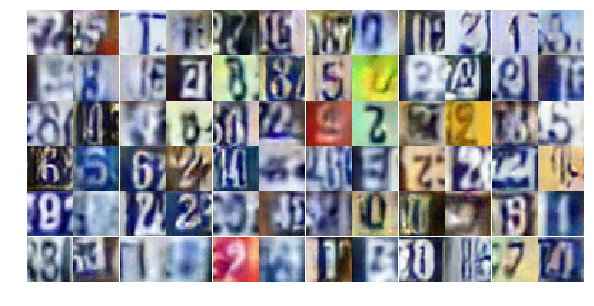

Epoch 17/25... Discriminator Loss: 0.9960... Generator Loss: 0.7634
Epoch 17/25... Discriminator Loss: 1.0300... Generator Loss: 0.7079
Epoch 17/25... Discriminator Loss: 0.6468... Generator Loss: 1.0482
Epoch 17/25... Discriminator Loss: 1.2567... Generator Loss: 0.4760
Epoch 17/25... Discriminator Loss: 1.2310... Generator Loss: 0.4874
Epoch 17/25... Discriminator Loss: 0.6114... Generator Loss: 1.6494
Epoch 17/25... Discriminator Loss: 0.8497... Generator Loss: 1.2800
Epoch 17/25... Discriminator Loss: 0.4094... Generator Loss: 1.5148
Epoch 17/25... Discriminator Loss: 0.5415... Generator Loss: 2.6363
Epoch 17/25... Discriminator Loss: 0.7937... Generator Loss: 0.9887


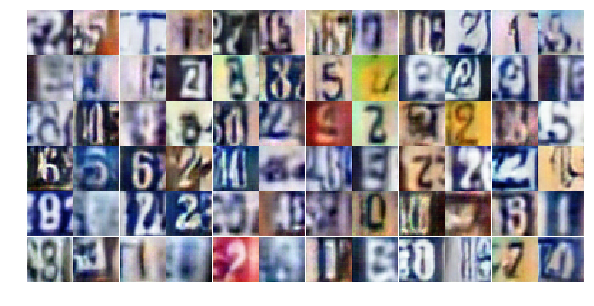

Epoch 17/25... Discriminator Loss: 0.8091... Generator Loss: 1.2414
Epoch 17/25... Discriminator Loss: 0.3528... Generator Loss: 2.5062
Epoch 17/25... Discriminator Loss: 0.6458... Generator Loss: 1.3505
Epoch 17/25... Discriminator Loss: 0.5098... Generator Loss: 1.3897
Epoch 17/25... Discriminator Loss: 0.7762... Generator Loss: 0.9047
Epoch 17/25... Discriminator Loss: 0.9108... Generator Loss: 0.7039
Epoch 17/25... Discriminator Loss: 1.4427... Generator Loss: 0.4188
Epoch 17/25... Discriminator Loss: 0.6272... Generator Loss: 1.0965
Epoch 17/25... Discriminator Loss: 0.8887... Generator Loss: 0.7715
Epoch 17/25... Discriminator Loss: 1.5957... Generator Loss: 0.3333


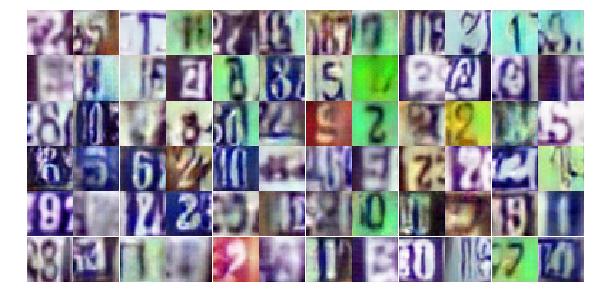

Epoch 17/25... Discriminator Loss: 1.1801... Generator Loss: 0.5794
Epoch 17/25... Discriminator Loss: 0.9557... Generator Loss: 0.8240
Epoch 17/25... Discriminator Loss: 0.6151... Generator Loss: 1.1586
Epoch 17/25... Discriminator Loss: 0.5160... Generator Loss: 1.7856
Epoch 18/25... Discriminator Loss: 1.1756... Generator Loss: 0.5594
Epoch 18/25... Discriminator Loss: 1.2806... Generator Loss: 0.5017
Epoch 18/25... Discriminator Loss: 0.9127... Generator Loss: 0.7484
Epoch 18/25... Discriminator Loss: 0.7416... Generator Loss: 0.8761
Epoch 18/25... Discriminator Loss: 0.9616... Generator Loss: 0.6611
Epoch 18/25... Discriminator Loss: 0.6413... Generator Loss: 1.7427


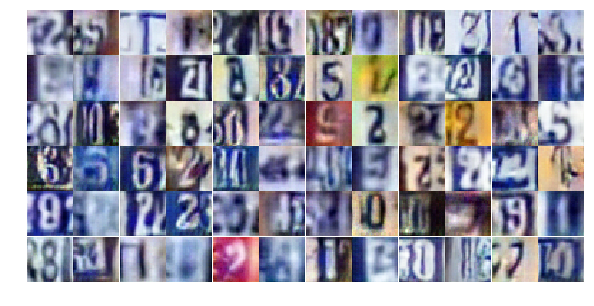

Epoch 18/25... Discriminator Loss: 0.4897... Generator Loss: 1.2674
Epoch 18/25... Discriminator Loss: 1.2931... Generator Loss: 0.4656
Epoch 18/25... Discriminator Loss: 0.9806... Generator Loss: 0.6424
Epoch 18/25... Discriminator Loss: 0.4429... Generator Loss: 1.6409
Epoch 18/25... Discriminator Loss: 0.6761... Generator Loss: 1.0638
Epoch 18/25... Discriminator Loss: 0.8154... Generator Loss: 0.8739
Epoch 18/25... Discriminator Loss: 0.6921... Generator Loss: 1.0207
Epoch 18/25... Discriminator Loss: 1.1877... Generator Loss: 0.5161
Epoch 18/25... Discriminator Loss: 0.6082... Generator Loss: 1.0899
Epoch 18/25... Discriminator Loss: 0.3291... Generator Loss: 2.1769


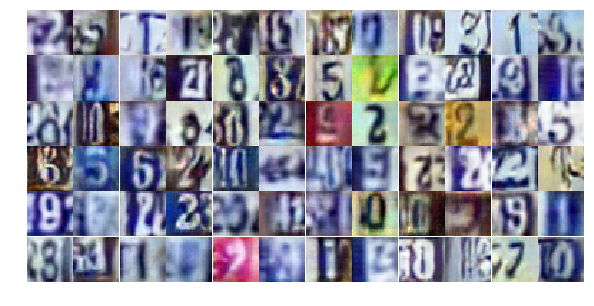

Epoch 18/25... Discriminator Loss: 0.5514... Generator Loss: 1.4052
Epoch 18/25... Discriminator Loss: 0.5786... Generator Loss: 2.1186
Epoch 18/25... Discriminator Loss: 0.9042... Generator Loss: 1.3303
Epoch 18/25... Discriminator Loss: 0.4749... Generator Loss: 1.4486
Epoch 18/25... Discriminator Loss: 1.0832... Generator Loss: 0.6104
Epoch 18/25... Discriminator Loss: 0.9745... Generator Loss: 0.6593
Epoch 18/25... Discriminator Loss: 0.8589... Generator Loss: 0.8268
Epoch 18/25... Discriminator Loss: 1.0119... Generator Loss: 0.6852
Epoch 18/25... Discriminator Loss: 0.7810... Generator Loss: 0.8438
Epoch 18/25... Discriminator Loss: 0.5881... Generator Loss: 1.2838


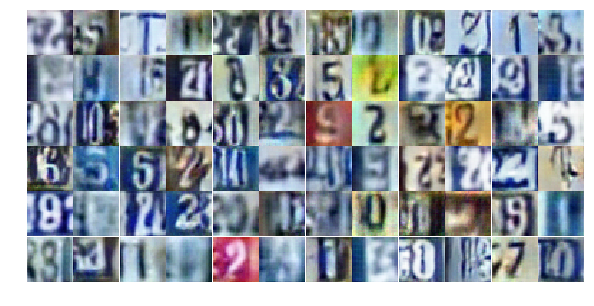

Epoch 18/25... Discriminator Loss: 0.3812... Generator Loss: 1.8849
Epoch 18/25... Discriminator Loss: 0.6932... Generator Loss: 1.1838
Epoch 18/25... Discriminator Loss: 0.6635... Generator Loss: 1.0018
Epoch 18/25... Discriminator Loss: 0.4897... Generator Loss: 1.4692
Epoch 18/25... Discriminator Loss: 0.9225... Generator Loss: 0.7073
Epoch 18/25... Discriminator Loss: 0.6081... Generator Loss: 1.2440
Epoch 18/25... Discriminator Loss: 0.8273... Generator Loss: 0.8309
Epoch 18/25... Discriminator Loss: 0.4281... Generator Loss: 1.6414
Epoch 18/25... Discriminator Loss: 0.4663... Generator Loss: 1.3863
Epoch 18/25... Discriminator Loss: 0.7474... Generator Loss: 0.9828


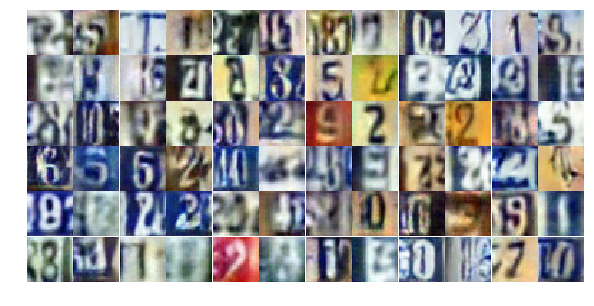

Epoch 18/25... Discriminator Loss: 0.4490... Generator Loss: 1.7473
Epoch 18/25... Discriminator Loss: 0.5264... Generator Loss: 1.5173
Epoch 18/25... Discriminator Loss: 0.5302... Generator Loss: 1.6514
Epoch 18/25... Discriminator Loss: 0.3910... Generator Loss: 1.8086
Epoch 18/25... Discriminator Loss: 0.8440... Generator Loss: 0.8762
Epoch 18/25... Discriminator Loss: 0.4142... Generator Loss: 1.6210
Epoch 18/25... Discriminator Loss: 0.9490... Generator Loss: 0.6807
Epoch 18/25... Discriminator Loss: 1.4137... Generator Loss: 3.0730
Epoch 18/25... Discriminator Loss: 1.3986... Generator Loss: 0.4407
Epoch 18/25... Discriminator Loss: 0.3474... Generator Loss: 2.0318


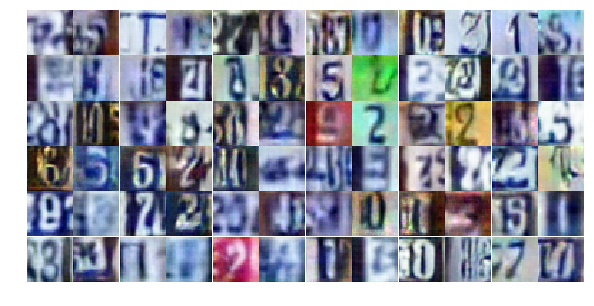

Epoch 18/25... Discriminator Loss: 0.7005... Generator Loss: 0.9873
Epoch 18/25... Discriminator Loss: 0.4891... Generator Loss: 1.5928
Epoch 18/25... Discriminator Loss: 0.7917... Generator Loss: 0.8367
Epoch 18/25... Discriminator Loss: 0.7862... Generator Loss: 1.2920
Epoch 18/25... Discriminator Loss: 0.5708... Generator Loss: 1.2566
Epoch 18/25... Discriminator Loss: 0.5491... Generator Loss: 1.3147
Epoch 18/25... Discriminator Loss: 0.4467... Generator Loss: 1.5142
Epoch 18/25... Discriminator Loss: 0.4981... Generator Loss: 1.2548
Epoch 18/25... Discriminator Loss: 0.8583... Generator Loss: 1.6093
Epoch 18/25... Discriminator Loss: 0.6508... Generator Loss: 1.1479


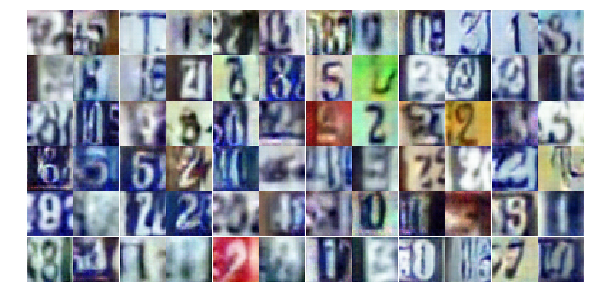

Epoch 18/25... Discriminator Loss: 0.6922... Generator Loss: 2.6617
Epoch 19/25... Discriminator Loss: 1.3004... Generator Loss: 0.4565
Epoch 19/25... Discriminator Loss: 1.2979... Generator Loss: 0.4409
Epoch 19/25... Discriminator Loss: 0.7540... Generator Loss: 1.0032
Epoch 19/25... Discriminator Loss: 0.4020... Generator Loss: 2.0022
Epoch 19/25... Discriminator Loss: 0.9190... Generator Loss: 0.7856
Epoch 19/25... Discriminator Loss: 0.6404... Generator Loss: 1.0980
Epoch 19/25... Discriminator Loss: 0.9154... Generator Loss: 0.8507
Epoch 19/25... Discriminator Loss: 0.6987... Generator Loss: 2.2087
Epoch 19/25... Discriminator Loss: 0.7470... Generator Loss: 0.9158


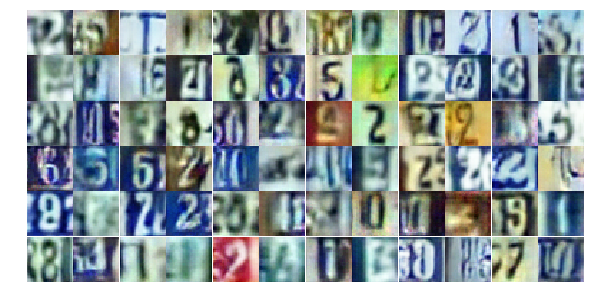

Epoch 19/25... Discriminator Loss: 0.6206... Generator Loss: 1.1075
Epoch 19/25... Discriminator Loss: 1.0256... Generator Loss: 0.5937
Epoch 19/25... Discriminator Loss: 0.9567... Generator Loss: 0.7083
Epoch 19/25... Discriminator Loss: 1.6953... Generator Loss: 0.2874
Epoch 19/25... Discriminator Loss: 1.2721... Generator Loss: 0.5604
Epoch 19/25... Discriminator Loss: 0.7217... Generator Loss: 0.9838
Epoch 19/25... Discriminator Loss: 0.8278... Generator Loss: 0.8367
Epoch 19/25... Discriminator Loss: 0.5274... Generator Loss: 1.5628
Epoch 19/25... Discriminator Loss: 0.6390... Generator Loss: 1.7522
Epoch 19/25... Discriminator Loss: 1.0541... Generator Loss: 0.6535


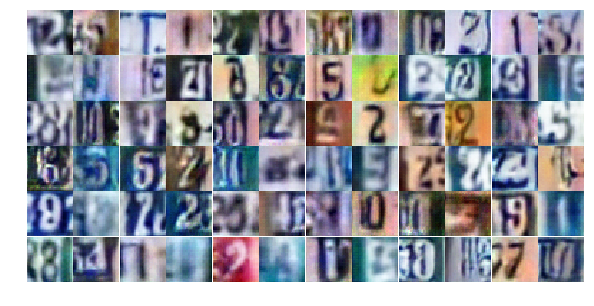

Epoch 19/25... Discriminator Loss: 1.3624... Generator Loss: 0.4306
Epoch 19/25... Discriminator Loss: 1.9840... Generator Loss: 0.2151
Epoch 19/25... Discriminator Loss: 1.4661... Generator Loss: 0.3562
Epoch 19/25... Discriminator Loss: 0.7831... Generator Loss: 0.8840
Epoch 19/25... Discriminator Loss: 1.6038... Generator Loss: 0.3496
Epoch 19/25... Discriminator Loss: 0.9656... Generator Loss: 0.6798
Epoch 19/25... Discriminator Loss: 0.6160... Generator Loss: 1.1179
Epoch 19/25... Discriminator Loss: 0.4318... Generator Loss: 1.4375
Epoch 19/25... Discriminator Loss: 0.6612... Generator Loss: 0.9805
Epoch 19/25... Discriminator Loss: 1.3022... Generator Loss: 0.5026


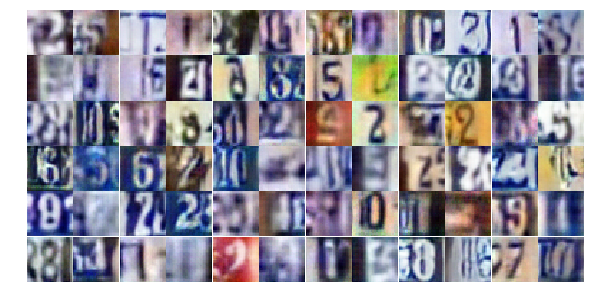

Epoch 19/25... Discriminator Loss: 0.9196... Generator Loss: 0.7315
Epoch 19/25... Discriminator Loss: 0.6825... Generator Loss: 1.0736
Epoch 19/25... Discriminator Loss: 0.7381... Generator Loss: 0.9801
Epoch 19/25... Discriminator Loss: 0.4803... Generator Loss: 1.3431
Epoch 19/25... Discriminator Loss: 0.8388... Generator Loss: 0.8693
Epoch 19/25... Discriminator Loss: 0.8012... Generator Loss: 1.1656
Epoch 19/25... Discriminator Loss: 0.6307... Generator Loss: 1.3287
Epoch 19/25... Discriminator Loss: 0.5212... Generator Loss: 1.2657
Epoch 19/25... Discriminator Loss: 0.8524... Generator Loss: 1.1374
Epoch 19/25... Discriminator Loss: 0.5484... Generator Loss: 1.2539


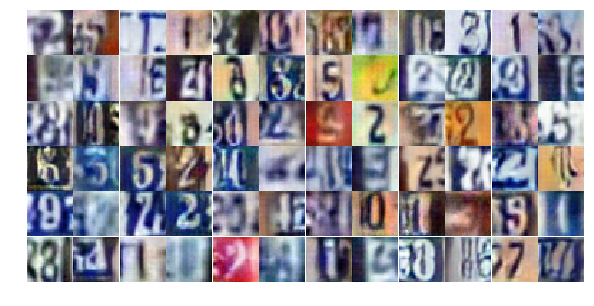

Epoch 19/25... Discriminator Loss: 0.5510... Generator Loss: 1.2139
Epoch 19/25... Discriminator Loss: 0.7571... Generator Loss: 1.4255
Epoch 19/25... Discriminator Loss: 0.9913... Generator Loss: 0.6781
Epoch 19/25... Discriminator Loss: 1.0485... Generator Loss: 0.6804
Epoch 19/25... Discriminator Loss: 0.7822... Generator Loss: 1.0112
Epoch 19/25... Discriminator Loss: 1.6433... Generator Loss: 0.4894
Epoch 19/25... Discriminator Loss: 0.6769... Generator Loss: 2.8433
Epoch 19/25... Discriminator Loss: 0.8342... Generator Loss: 2.5015
Epoch 19/25... Discriminator Loss: 0.5518... Generator Loss: 1.4149
Epoch 19/25... Discriminator Loss: 0.8921... Generator Loss: 0.8628


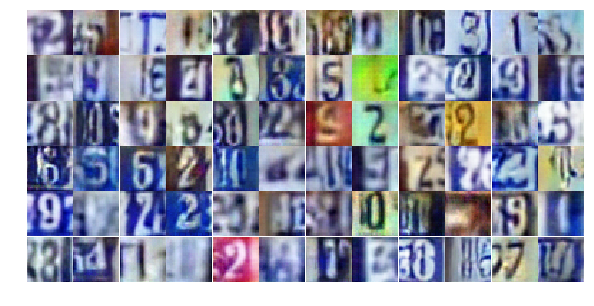

Epoch 19/25... Discriminator Loss: 0.9800... Generator Loss: 0.6472
Epoch 19/25... Discriminator Loss: 1.0584... Generator Loss: 0.6150
Epoch 19/25... Discriminator Loss: 0.5088... Generator Loss: 2.0640
Epoch 19/25... Discriminator Loss: 1.1431... Generator Loss: 0.6042
Epoch 19/25... Discriminator Loss: 0.7295... Generator Loss: 1.0487
Epoch 19/25... Discriminator Loss: 0.7313... Generator Loss: 1.0336
Epoch 19/25... Discriminator Loss: 1.1389... Generator Loss: 0.6066
Epoch 19/25... Discriminator Loss: 0.5047... Generator Loss: 1.7717
Epoch 20/25... Discriminator Loss: 0.6697... Generator Loss: 1.0016
Epoch 20/25... Discriminator Loss: 0.8587... Generator Loss: 0.7830


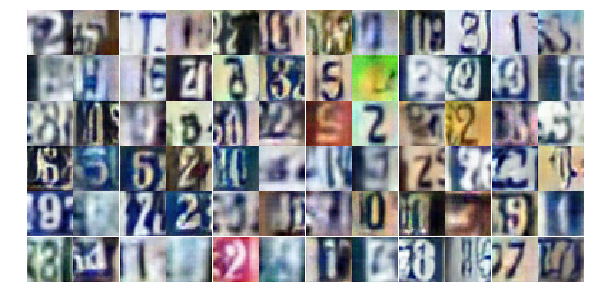

Epoch 20/25... Discriminator Loss: 0.4477... Generator Loss: 1.4372
Epoch 20/25... Discriminator Loss: 0.8494... Generator Loss: 0.8933
Epoch 20/25... Discriminator Loss: 1.2953... Generator Loss: 0.4260
Epoch 20/25... Discriminator Loss: 1.0707... Generator Loss: 0.6147
Epoch 20/25... Discriminator Loss: 0.6280... Generator Loss: 1.1683
Epoch 20/25... Discriminator Loss: 0.7163... Generator Loss: 0.9803
Epoch 20/25... Discriminator Loss: 0.6777... Generator Loss: 2.3307
Epoch 20/25... Discriminator Loss: 0.7146... Generator Loss: 1.1758
Epoch 20/25... Discriminator Loss: 0.6196... Generator Loss: 1.3266
Epoch 20/25... Discriminator Loss: 0.5628... Generator Loss: 1.0961


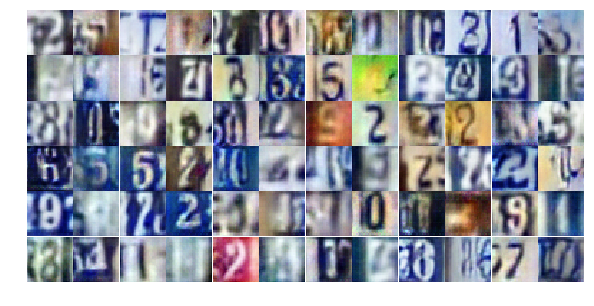

Epoch 20/25... Discriminator Loss: 1.3856... Generator Loss: 0.4733
Epoch 20/25... Discriminator Loss: 1.2513... Generator Loss: 0.4598
Epoch 20/25... Discriminator Loss: 0.5707... Generator Loss: 1.5675
Epoch 20/25... Discriminator Loss: 2.3999... Generator Loss: 0.2474
Epoch 20/25... Discriminator Loss: 1.6201... Generator Loss: 0.4594
Epoch 20/25... Discriminator Loss: 1.0816... Generator Loss: 0.6773
Epoch 20/25... Discriminator Loss: 0.8664... Generator Loss: 1.0632
Epoch 20/25... Discriminator Loss: 0.8211... Generator Loss: 0.7784
Epoch 20/25... Discriminator Loss: 0.7674... Generator Loss: 0.9152
Epoch 20/25... Discriminator Loss: 1.0088... Generator Loss: 0.6984


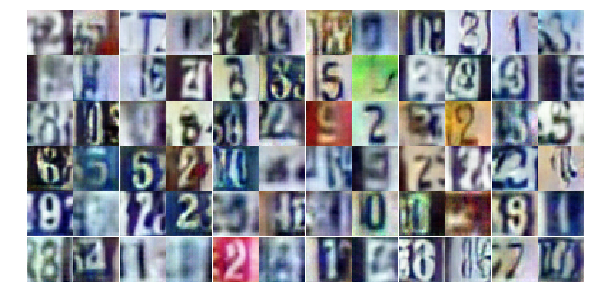

Epoch 20/25... Discriminator Loss: 0.7108... Generator Loss: 0.9453
Epoch 20/25... Discriminator Loss: 1.0674... Generator Loss: 0.6286
Epoch 20/25... Discriminator Loss: 0.5328... Generator Loss: 1.1644
Epoch 20/25... Discriminator Loss: 1.5294... Generator Loss: 0.3900
Epoch 20/25... Discriminator Loss: 0.9252... Generator Loss: 0.7802
Epoch 20/25... Discriminator Loss: 0.5496... Generator Loss: 1.1305
Epoch 20/25... Discriminator Loss: 0.6433... Generator Loss: 1.3418
Epoch 20/25... Discriminator Loss: 1.4533... Generator Loss: 0.4269
Epoch 20/25... Discriminator Loss: 0.9096... Generator Loss: 0.7414
Epoch 20/25... Discriminator Loss: 0.4968... Generator Loss: 1.2218


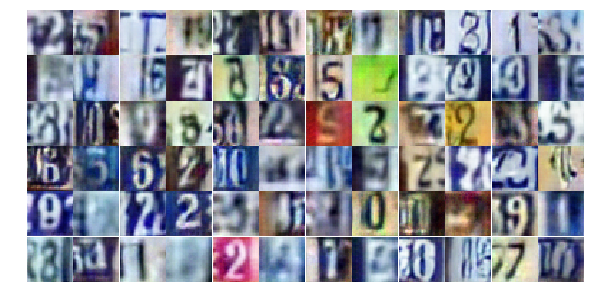

Epoch 20/25... Discriminator Loss: 0.6827... Generator Loss: 1.3370
Epoch 20/25... Discriminator Loss: 0.5411... Generator Loss: 1.2212
Epoch 20/25... Discriminator Loss: 1.6704... Generator Loss: 0.2986
Epoch 20/25... Discriminator Loss: 0.9673... Generator Loss: 1.1024
Epoch 20/25... Discriminator Loss: 0.8659... Generator Loss: 1.1000
Epoch 20/25... Discriminator Loss: 0.6120... Generator Loss: 1.1882
Epoch 20/25... Discriminator Loss: 0.7785... Generator Loss: 0.9410
Epoch 20/25... Discriminator Loss: 0.7279... Generator Loss: 1.1101
Epoch 20/25... Discriminator Loss: 0.5935... Generator Loss: 1.1156
Epoch 20/25... Discriminator Loss: 0.8216... Generator Loss: 0.7712


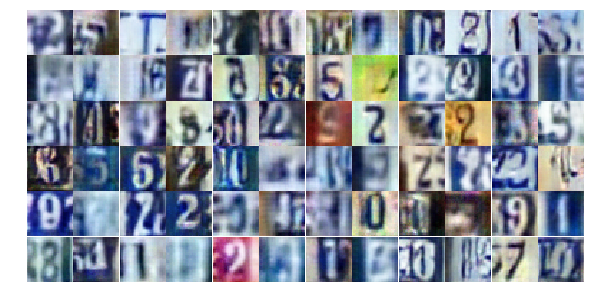

Epoch 20/25... Discriminator Loss: 0.7309... Generator Loss: 0.9743
Epoch 20/25... Discriminator Loss: 0.8552... Generator Loss: 0.7353
Epoch 20/25... Discriminator Loss: 0.6425... Generator Loss: 2.1446
Epoch 20/25... Discriminator Loss: 0.5758... Generator Loss: 1.2150
Epoch 20/25... Discriminator Loss: 0.6781... Generator Loss: 0.9960
Epoch 20/25... Discriminator Loss: 0.8760... Generator Loss: 0.7982
Epoch 20/25... Discriminator Loss: 1.1108... Generator Loss: 0.6144
Epoch 20/25... Discriminator Loss: 0.5116... Generator Loss: 1.5819
Epoch 20/25... Discriminator Loss: 0.9286... Generator Loss: 0.7165
Epoch 20/25... Discriminator Loss: 0.6922... Generator Loss: 1.0034


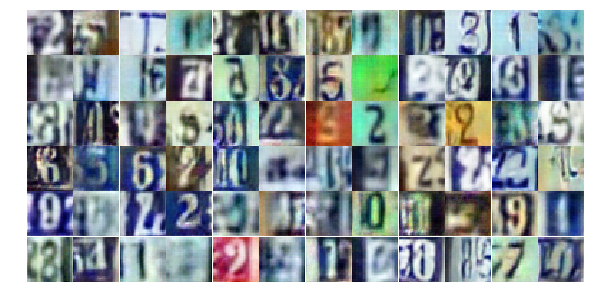

Epoch 20/25... Discriminator Loss: 0.5470... Generator Loss: 1.2120
Epoch 20/25... Discriminator Loss: 1.1035... Generator Loss: 0.6364
Epoch 20/25... Discriminator Loss: 0.4635... Generator Loss: 1.3351
Epoch 20/25... Discriminator Loss: 0.9005... Generator Loss: 0.7888
Epoch 20/25... Discriminator Loss: 0.5459... Generator Loss: 1.1504
Epoch 20/25... Discriminator Loss: 0.4310... Generator Loss: 1.5491
Epoch 21/25... Discriminator Loss: 1.3129... Generator Loss: 0.4868
Epoch 21/25... Discriminator Loss: 0.6702... Generator Loss: 1.2326
Epoch 21/25... Discriminator Loss: 1.5978... Generator Loss: 0.3197
Epoch 21/25... Discriminator Loss: 1.2251... Generator Loss: 0.5238


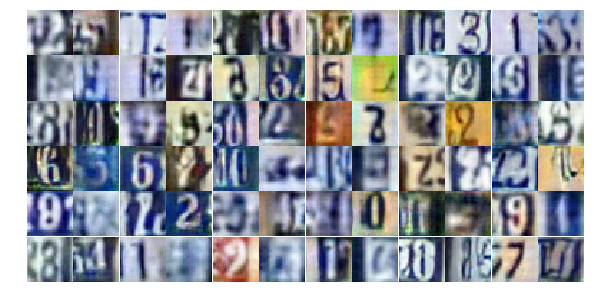

Epoch 21/25... Discriminator Loss: 0.7298... Generator Loss: 0.9844
Epoch 21/25... Discriminator Loss: 1.3505... Generator Loss: 0.4657
Epoch 21/25... Discriminator Loss: 0.5404... Generator Loss: 1.2657
Epoch 21/25... Discriminator Loss: 0.5224... Generator Loss: 1.1507
Epoch 21/25... Discriminator Loss: 0.7981... Generator Loss: 0.8423
Epoch 21/25... Discriminator Loss: 0.7473... Generator Loss: 0.9376
Epoch 21/25... Discriminator Loss: 0.8718... Generator Loss: 0.7916
Epoch 21/25... Discriminator Loss: 0.7011... Generator Loss: 1.3609
Epoch 21/25... Discriminator Loss: 0.5660... Generator Loss: 1.2050
Epoch 21/25... Discriminator Loss: 0.9770... Generator Loss: 0.6940


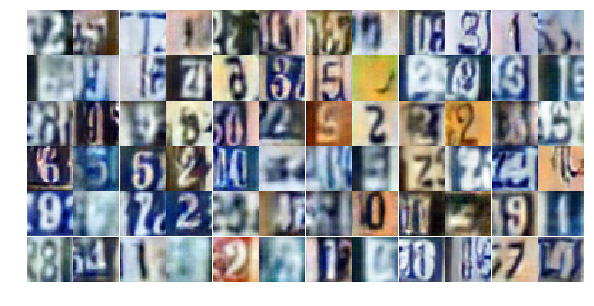

Epoch 21/25... Discriminator Loss: 0.4745... Generator Loss: 1.3890
Epoch 21/25... Discriminator Loss: 0.7216... Generator Loss: 0.9277
Epoch 21/25... Discriminator Loss: 1.0309... Generator Loss: 0.9299
Epoch 21/25... Discriminator Loss: 0.8530... Generator Loss: 0.8048
Epoch 21/25... Discriminator Loss: 0.5484... Generator Loss: 1.4889
Epoch 21/25... Discriminator Loss: 1.4278... Generator Loss: 0.3815
Epoch 21/25... Discriminator Loss: 0.7511... Generator Loss: 0.9866
Epoch 21/25... Discriminator Loss: 0.5302... Generator Loss: 1.1845
Epoch 21/25... Discriminator Loss: 0.6027... Generator Loss: 1.1896
Epoch 21/25... Discriminator Loss: 0.7515... Generator Loss: 0.8710


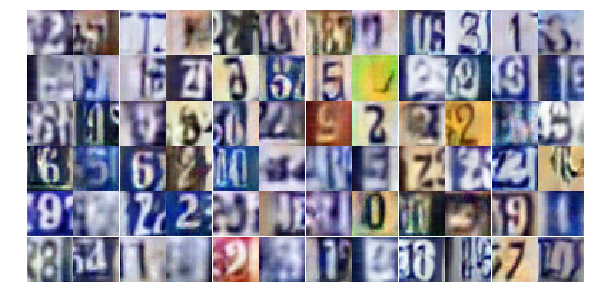

Epoch 21/25... Discriminator Loss: 1.2368... Generator Loss: 0.5759
Epoch 21/25... Discriminator Loss: 0.3436... Generator Loss: 1.6469
Epoch 21/25... Discriminator Loss: 0.9516... Generator Loss: 0.6814
Epoch 21/25... Discriminator Loss: 0.9825... Generator Loss: 0.7149
Epoch 21/25... Discriminator Loss: 1.0034... Generator Loss: 0.7146
Epoch 21/25... Discriminator Loss: 0.9458... Generator Loss: 0.7334
Epoch 21/25... Discriminator Loss: 0.6057... Generator Loss: 1.1543
Epoch 21/25... Discriminator Loss: 0.7073... Generator Loss: 1.0836
Epoch 21/25... Discriminator Loss: 1.1795... Generator Loss: 0.5109
Epoch 21/25... Discriminator Loss: 2.1597... Generator Loss: 0.2290


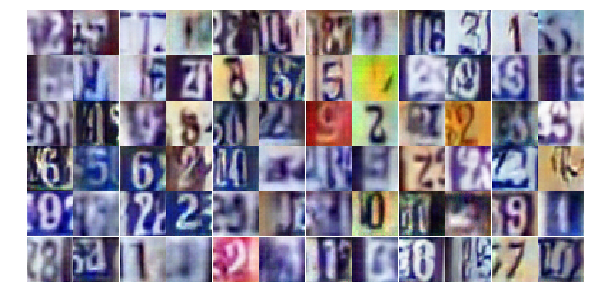

Epoch 21/25... Discriminator Loss: 0.9847... Generator Loss: 0.6481
Epoch 21/25... Discriminator Loss: 0.8134... Generator Loss: 0.8450
Epoch 21/25... Discriminator Loss: 1.5354... Generator Loss: 0.3692
Epoch 21/25... Discriminator Loss: 0.5589... Generator Loss: 1.4191
Epoch 21/25... Discriminator Loss: 0.5685... Generator Loss: 1.1873
Epoch 21/25... Discriminator Loss: 1.5581... Generator Loss: 0.4997
Epoch 21/25... Discriminator Loss: 1.8681... Generator Loss: 0.2333
Epoch 21/25... Discriminator Loss: 1.1929... Generator Loss: 0.5396
Epoch 21/25... Discriminator Loss: 0.8826... Generator Loss: 0.8176
Epoch 21/25... Discriminator Loss: 0.2372... Generator Loss: 2.1849


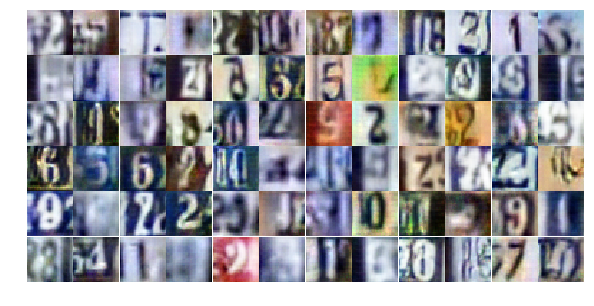

Epoch 21/25... Discriminator Loss: 0.8327... Generator Loss: 0.8624
Epoch 21/25... Discriminator Loss: 1.2038... Generator Loss: 0.5692
Epoch 21/25... Discriminator Loss: 0.6737... Generator Loss: 1.0946
Epoch 21/25... Discriminator Loss: 1.3353... Generator Loss: 0.5214
Epoch 21/25... Discriminator Loss: 0.4045... Generator Loss: 1.5362
Epoch 21/25... Discriminator Loss: 0.7267... Generator Loss: 1.4693
Epoch 21/25... Discriminator Loss: 0.6678... Generator Loss: 1.1106
Epoch 21/25... Discriminator Loss: 0.7812... Generator Loss: 0.9205
Epoch 21/25... Discriminator Loss: 1.1413... Generator Loss: 0.5281
Epoch 21/25... Discriminator Loss: 1.2295... Generator Loss: 0.6734


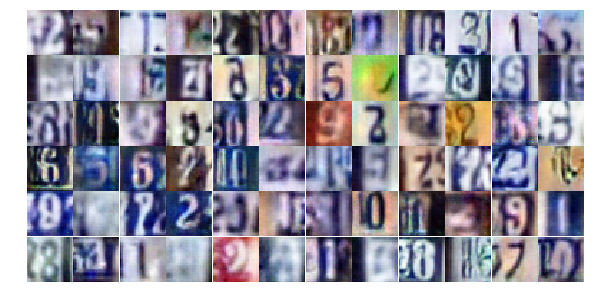

Epoch 21/25... Discriminator Loss: 0.6406... Generator Loss: 1.2083
Epoch 21/25... Discriminator Loss: 0.6888... Generator Loss: 1.4298
Epoch 21/25... Discriminator Loss: 0.7266... Generator Loss: 1.1327
Epoch 22/25... Discriminator Loss: 0.9011... Generator Loss: 1.1789
Epoch 22/25... Discriminator Loss: 1.1180... Generator Loss: 0.5785
Epoch 22/25... Discriminator Loss: 0.7893... Generator Loss: 0.9524
Epoch 22/25... Discriminator Loss: 0.5499... Generator Loss: 1.3854
Epoch 22/25... Discriminator Loss: 0.4746... Generator Loss: 1.3999
Epoch 22/25... Discriminator Loss: 0.7795... Generator Loss: 0.9045
Epoch 22/25... Discriminator Loss: 0.7106... Generator Loss: 1.0745


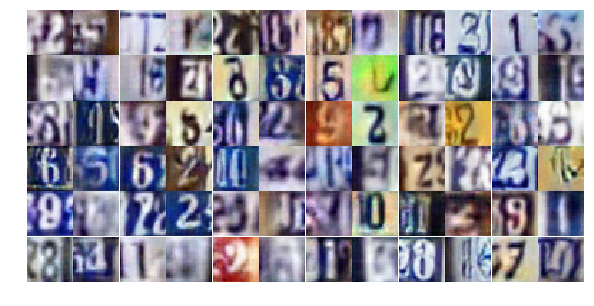

Epoch 22/25... Discriminator Loss: 0.4686... Generator Loss: 1.7097
Epoch 22/25... Discriminator Loss: 0.7684... Generator Loss: 0.9811
Epoch 22/25... Discriminator Loss: 1.4005... Generator Loss: 0.4282
Epoch 22/25... Discriminator Loss: 1.0365... Generator Loss: 0.6393
Epoch 22/25... Discriminator Loss: 1.0235... Generator Loss: 0.7107
Epoch 22/25... Discriminator Loss: 0.5626... Generator Loss: 1.4992
Epoch 22/25... Discriminator Loss: 0.6859... Generator Loss: 1.1017
Epoch 22/25... Discriminator Loss: 0.5296... Generator Loss: 1.3773
Epoch 22/25... Discriminator Loss: 0.9889... Generator Loss: 0.7455
Epoch 22/25... Discriminator Loss: 1.6542... Generator Loss: 0.3862


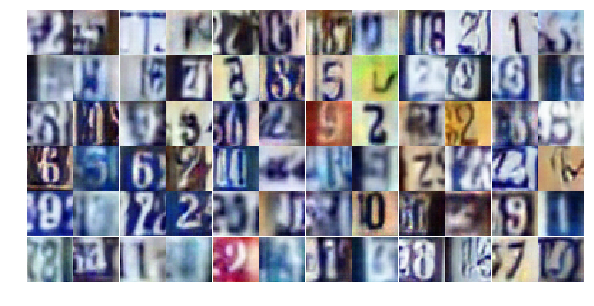

Epoch 22/25... Discriminator Loss: 0.5570... Generator Loss: 1.4159
Epoch 22/25... Discriminator Loss: 0.7185... Generator Loss: 0.9218
Epoch 22/25... Discriminator Loss: 1.1257... Generator Loss: 0.5596
Epoch 22/25... Discriminator Loss: 0.3278... Generator Loss: 2.2656
Epoch 22/25... Discriminator Loss: 0.5463... Generator Loss: 1.2663
Epoch 22/25... Discriminator Loss: 1.0196... Generator Loss: 0.5938
Epoch 22/25... Discriminator Loss: 0.4074... Generator Loss: 2.0913
Epoch 22/25... Discriminator Loss: 0.4259... Generator Loss: 1.6720
Epoch 22/25... Discriminator Loss: 0.4579... Generator Loss: 1.5821
Epoch 22/25... Discriminator Loss: 1.7482... Generator Loss: 0.3105


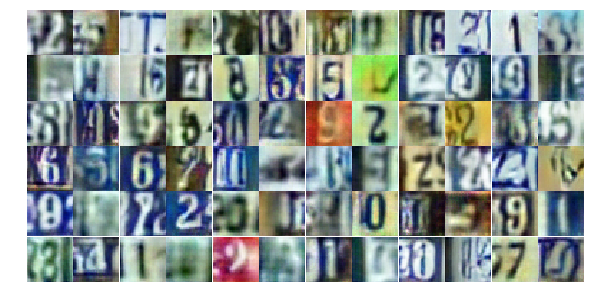

Epoch 22/25... Discriminator Loss: 0.8185... Generator Loss: 0.8293
Epoch 22/25... Discriminator Loss: 0.4501... Generator Loss: 1.9327
Epoch 22/25... Discriminator Loss: 0.8030... Generator Loss: 0.9535
Epoch 22/25... Discriminator Loss: 0.9129... Generator Loss: 0.8215
Epoch 22/25... Discriminator Loss: 1.0064... Generator Loss: 0.7275
Epoch 22/25... Discriminator Loss: 1.2689... Generator Loss: 0.4997
Epoch 22/25... Discriminator Loss: 1.6541... Generator Loss: 0.3599
Epoch 22/25... Discriminator Loss: 0.6775... Generator Loss: 1.1076
Epoch 22/25... Discriminator Loss: 0.6681... Generator Loss: 1.2582
Epoch 22/25... Discriminator Loss: 1.6977... Generator Loss: 0.3260


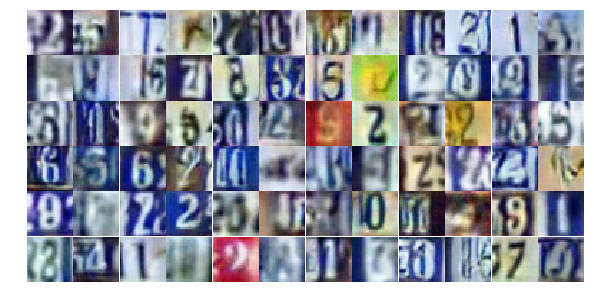

Epoch 22/25... Discriminator Loss: 0.7473... Generator Loss: 1.0168
Epoch 22/25... Discriminator Loss: 0.7518... Generator Loss: 0.9415
Epoch 22/25... Discriminator Loss: 0.3353... Generator Loss: 1.8003
Epoch 22/25... Discriminator Loss: 0.6895... Generator Loss: 1.0666
Epoch 22/25... Discriminator Loss: 0.7466... Generator Loss: 0.8053
Epoch 22/25... Discriminator Loss: 0.8018... Generator Loss: 0.9326
Epoch 22/25... Discriminator Loss: 0.9257... Generator Loss: 0.7941
Epoch 22/25... Discriminator Loss: 1.0046... Generator Loss: 0.6838
Epoch 22/25... Discriminator Loss: 1.6373... Generator Loss: 0.3668
Epoch 22/25... Discriminator Loss: 0.9878... Generator Loss: 0.7344


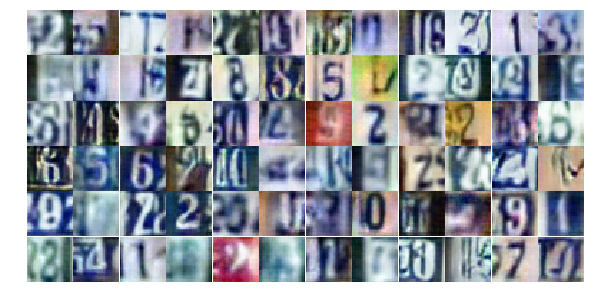

Epoch 22/25... Discriminator Loss: 1.5213... Generator Loss: 0.3451
Epoch 22/25... Discriminator Loss: 0.6068... Generator Loss: 1.0984
Epoch 22/25... Discriminator Loss: 1.1088... Generator Loss: 0.5877
Epoch 22/25... Discriminator Loss: 1.0497... Generator Loss: 0.6610
Epoch 22/25... Discriminator Loss: 1.3420... Generator Loss: 0.5434
Epoch 22/25... Discriminator Loss: 1.3251... Generator Loss: 0.4624
Epoch 22/25... Discriminator Loss: 0.7665... Generator Loss: 1.1626
Epoch 22/25... Discriminator Loss: 0.7464... Generator Loss: 0.9098
Epoch 22/25... Discriminator Loss: 1.0136... Generator Loss: 0.7409
Epoch 22/25... Discriminator Loss: 0.7094... Generator Loss: 1.0010


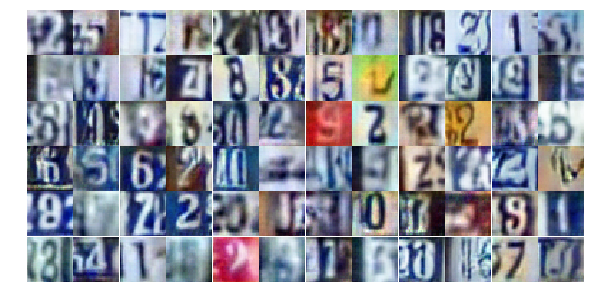

Epoch 23/25... Discriminator Loss: 0.5171... Generator Loss: 1.5498
Epoch 23/25... Discriminator Loss: 0.5782... Generator Loss: 1.2049
Epoch 23/25... Discriminator Loss: 0.8390... Generator Loss: 0.8762
Epoch 23/25... Discriminator Loss: 0.6291... Generator Loss: 1.0832
Epoch 23/25... Discriminator Loss: 0.7654... Generator Loss: 0.8471
Epoch 23/25... Discriminator Loss: 1.6051... Generator Loss: 0.3714
Epoch 23/25... Discriminator Loss: 1.5635... Generator Loss: 0.4221
Epoch 23/25... Discriminator Loss: 0.8876... Generator Loss: 0.8293
Epoch 23/25... Discriminator Loss: 0.7550... Generator Loss: 0.8615
Epoch 23/25... Discriminator Loss: 0.4344... Generator Loss: 1.5334


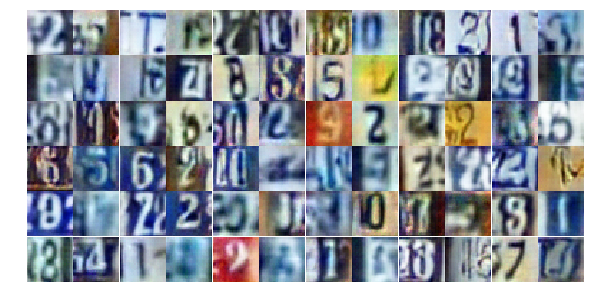

Epoch 23/25... Discriminator Loss: 0.6644... Generator Loss: 1.0114
Epoch 23/25... Discriminator Loss: 0.8492... Generator Loss: 0.7693
Epoch 23/25... Discriminator Loss: 0.8626... Generator Loss: 0.8161
Epoch 23/25... Discriminator Loss: 0.7216... Generator Loss: 0.9777
Epoch 23/25... Discriminator Loss: 0.4744... Generator Loss: 1.4587
Epoch 23/25... Discriminator Loss: 1.5326... Generator Loss: 0.4034
Epoch 23/25... Discriminator Loss: 0.8431... Generator Loss: 0.7847
Epoch 23/25... Discriminator Loss: 0.6600... Generator Loss: 1.1076
Epoch 23/25... Discriminator Loss: 2.3932... Generator Loss: 4.9455
Epoch 23/25... Discriminator Loss: 0.8975... Generator Loss: 1.9471


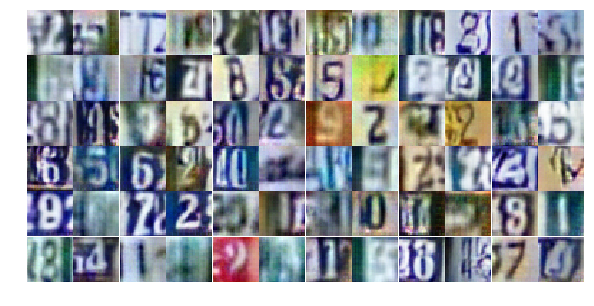

Epoch 23/25... Discriminator Loss: 1.9067... Generator Loss: 0.3133
Epoch 23/25... Discriminator Loss: 0.5821... Generator Loss: 1.4526
Epoch 23/25... Discriminator Loss: 0.9875... Generator Loss: 0.7025
Epoch 23/25... Discriminator Loss: 0.7678... Generator Loss: 0.9892
Epoch 23/25... Discriminator Loss: 0.6962... Generator Loss: 1.8478
Epoch 23/25... Discriminator Loss: 0.8041... Generator Loss: 0.8557
Epoch 23/25... Discriminator Loss: 1.1125... Generator Loss: 0.6502
Epoch 23/25... Discriminator Loss: 0.7599... Generator Loss: 1.1455
Epoch 23/25... Discriminator Loss: 0.6406... Generator Loss: 1.4352
Epoch 23/25... Discriminator Loss: 1.3412... Generator Loss: 0.4449


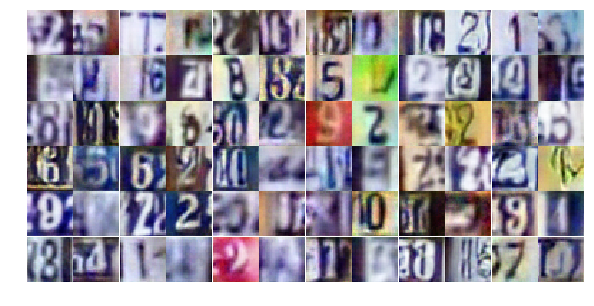

Epoch 23/25... Discriminator Loss: 0.6473... Generator Loss: 1.0631
Epoch 23/25... Discriminator Loss: 0.7672... Generator Loss: 0.9848
Epoch 23/25... Discriminator Loss: 0.7393... Generator Loss: 1.0421
Epoch 23/25... Discriminator Loss: 1.2083... Generator Loss: 0.5205
Epoch 23/25... Discriminator Loss: 0.9937... Generator Loss: 0.6623
Epoch 23/25... Discriminator Loss: 1.2851... Generator Loss: 0.4756
Epoch 23/25... Discriminator Loss: 0.8800... Generator Loss: 0.8994
Epoch 23/25... Discriminator Loss: 0.6030... Generator Loss: 1.1023
Epoch 23/25... Discriminator Loss: 0.5168... Generator Loss: 1.4495
Epoch 23/25... Discriminator Loss: 0.5315... Generator Loss: 1.2904


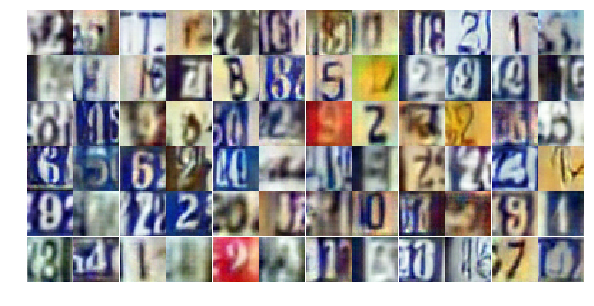

Epoch 23/25... Discriminator Loss: 0.7932... Generator Loss: 1.0761
Epoch 23/25... Discriminator Loss: 0.7573... Generator Loss: 0.8631
Epoch 23/25... Discriminator Loss: 1.1322... Generator Loss: 0.6045
Epoch 23/25... Discriminator Loss: 0.5563... Generator Loss: 1.2542
Epoch 23/25... Discriminator Loss: 0.7718... Generator Loss: 1.1396
Epoch 23/25... Discriminator Loss: 0.9082... Generator Loss: 0.7988
Epoch 23/25... Discriminator Loss: 0.6334... Generator Loss: 1.1077
Epoch 23/25... Discriminator Loss: 1.2687... Generator Loss: 0.4975
Epoch 23/25... Discriminator Loss: 0.7585... Generator Loss: 0.9768
Epoch 23/25... Discriminator Loss: 0.9185... Generator Loss: 0.7404


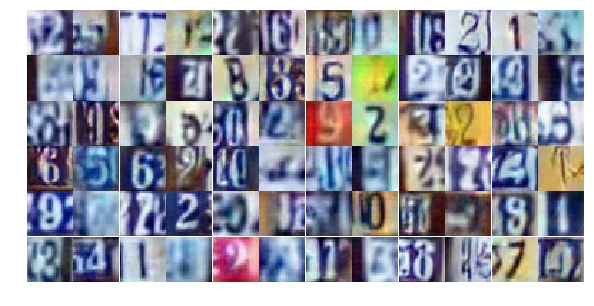

Epoch 23/25... Discriminator Loss: 0.7604... Generator Loss: 0.8898
Epoch 23/25... Discriminator Loss: 1.1236... Generator Loss: 0.5934
Epoch 23/25... Discriminator Loss: 1.0745... Generator Loss: 0.7080
Epoch 23/25... Discriminator Loss: 0.3714... Generator Loss: 1.7767
Epoch 23/25... Discriminator Loss: 1.2272... Generator Loss: 0.6343
Epoch 23/25... Discriminator Loss: 0.7833... Generator Loss: 0.9202
Epoch 23/25... Discriminator Loss: 1.0001... Generator Loss: 0.5898
Epoch 24/25... Discriminator Loss: 0.7541... Generator Loss: 0.9591
Epoch 24/25... Discriminator Loss: 0.7986... Generator Loss: 1.0684
Epoch 24/25... Discriminator Loss: 1.2501... Generator Loss: 0.5136


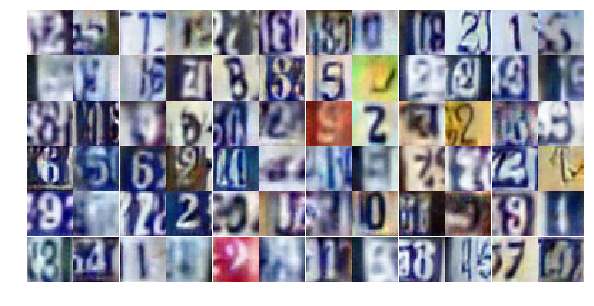

Epoch 24/25... Discriminator Loss: 0.6186... Generator Loss: 1.5765
Epoch 24/25... Discriminator Loss: 0.7715... Generator Loss: 0.9220
Epoch 24/25... Discriminator Loss: 0.5926... Generator Loss: 1.1308
Epoch 24/25... Discriminator Loss: 0.7936... Generator Loss: 1.0311
Epoch 24/25... Discriminator Loss: 0.6551... Generator Loss: 1.0511
Epoch 24/25... Discriminator Loss: 0.8315... Generator Loss: 0.8017
Epoch 24/25... Discriminator Loss: 0.6278... Generator Loss: 1.1361
Epoch 24/25... Discriminator Loss: 1.0993... Generator Loss: 0.6172
Epoch 24/25... Discriminator Loss: 0.4327... Generator Loss: 1.4616
Epoch 24/25... Discriminator Loss: 0.5141... Generator Loss: 1.4441


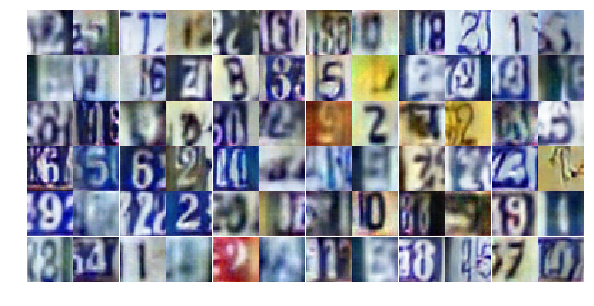

Epoch 24/25... Discriminator Loss: 1.3519... Generator Loss: 0.5099
Epoch 24/25... Discriminator Loss: 0.8499... Generator Loss: 0.9330
Epoch 24/25... Discriminator Loss: 1.8190... Generator Loss: 0.3657
Epoch 24/25... Discriminator Loss: 0.4680... Generator Loss: 1.5415
Epoch 24/25... Discriminator Loss: 0.6248... Generator Loss: 1.2476
Epoch 24/25... Discriminator Loss: 1.1557... Generator Loss: 0.6386
Epoch 24/25... Discriminator Loss: 0.4540... Generator Loss: 1.4073
Epoch 24/25... Discriminator Loss: 0.8037... Generator Loss: 0.9157
Epoch 24/25... Discriminator Loss: 1.2611... Generator Loss: 0.5268
Epoch 24/25... Discriminator Loss: 0.6268... Generator Loss: 1.1536


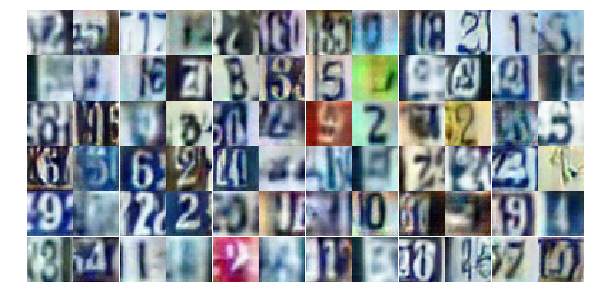

Epoch 24/25... Discriminator Loss: 1.2106... Generator Loss: 0.5606
Epoch 24/25... Discriminator Loss: 0.6039... Generator Loss: 1.1417
Epoch 24/25... Discriminator Loss: 0.6577... Generator Loss: 1.2705
Epoch 24/25... Discriminator Loss: 1.6346... Generator Loss: 0.3726
Epoch 24/25... Discriminator Loss: 0.6587... Generator Loss: 2.4500
Epoch 24/25... Discriminator Loss: 0.4895... Generator Loss: 1.3820
Epoch 24/25... Discriminator Loss: 0.4852... Generator Loss: 1.9825
Epoch 24/25... Discriminator Loss: 0.5609... Generator Loss: 1.7287
Epoch 24/25... Discriminator Loss: 0.6707... Generator Loss: 0.9804
Epoch 24/25... Discriminator Loss: 1.0071... Generator Loss: 0.6653


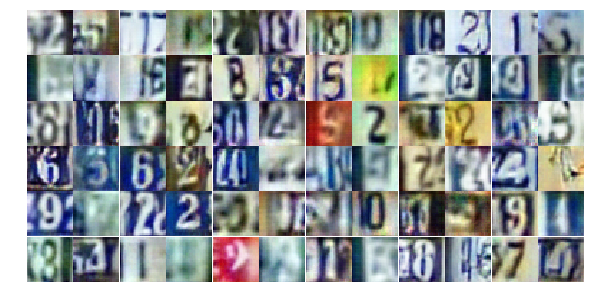

Epoch 24/25... Discriminator Loss: 0.4567... Generator Loss: 1.5296
Epoch 24/25... Discriminator Loss: 0.4717... Generator Loss: 1.3950


In [ ]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))